All needed libraries and steps

In [3]:
#!pip3 install plotly==4.14.3
#!pip3 install -U datapane
#!pip3 install matplotlib
#!pip3 install -U scikit-learn scipy matplotlib
#!jupyter notebook --NotebookApp.iopub_data_rate_limit=1.0e10 --allow-root

import plotly.express as px
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from plotly.subplots import make_subplots
from pandas import DataFrame
from datetime import datetime, date, time, timedelta
import pandas as pd
import operator
import numpy as np
import datapane as dp
pd.options.mode.chained_assignment = None  # default='warn'
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from itertools import islice
import plotly.graph_objects as go
import json

Data Import

In [4]:
#Import LTE network data from JSON file
data = []
with open('LTE.json') as f:
    for line in f:
        data.append(json.loads(line))

        #Convert JSON data from Python dict to DF
LTE_DATA = pd.json_normalize(data)
LTE_DATA.head()

#Import LTE network Ping data from JSON file
data = []
with open('Ping.json') as f:
    for line in f:
        data.append(json.loads(line))

        #Convert JSON data from Python dict to DF
LTE_PING = pd.json_normalize(data)
LTE_PING.head()

,interface,timestamp,net_param.avg_latency,net_param.max_latency,net_param.packet_loss_rate,uav_param.mode,uav_param.status,uav_param.battery,uav_param.attitude.pitch,uav_param.attitude.yaw,...,gps_param.altitude,gps_param.groundspeed,gps_param.velocity.vx,gps_param.velocity.vy,gps_param.velocity.vz,gps_param.head,gps_param.hdop,gps_param.vdop,gps_param.satellites,gps_param.fix_type
0,eth1,2021-05-22 13:50:22.168969,47.028,68.930,0.0,POSHOLD,STANDBY,24.48,-0.03359268605709076,-3.1376469135284424,...,16.52,0.11406989395618439,-0.08,0.07,0.09,180,71,105,15,4
1,eth1,2021-05-22 13:50:22.168969,47.028,68.930,0.0,POSHOLD,STANDBY,24.48,-0.03359268605709076,-3.1376469135284424,...,16.52,0.11406989395618439,-0.08,0.07,0.09,180,71,105,15,4
2,eth1,2021-05-22 13:50:37.145031,38.270,46.956,0.0,POSHOLD,STANDBY,24.478,-0.033754583448171616,-3.1396305561065674,...,16.61,0.11199898272752762,-0.06,0.09,0.08,180,71,105,15,4
3,eth1,2021-05-22 13:50:37.145031,38.270,46.956,0.0,POSHOLD,STANDBY,24.478,-0.033754583448171616,-3.1396305561065674,...,16.61,0.11199898272752762,-0.06,0.09,0.08,180,71,105,15,4
4,eth1,2021-05-22 13:50:52.237218,43.785,68.989,0.0,POSHOLD,STANDBY,24.474,-0.033050715923309326,3.1409029960632324,...,16.65,0.1331551969051361,-0.08,0.1,0.08,179,71,106,15,4


Preliminary Data Clean

In [5]:
#Drop duplicate data where rows have same timestamp
LTE_DATA = LTE_DATA.drop_duplicates(subset=['timestamp'])
LTE_PING = LTE_PING.drop_duplicates(subset=['timestamp'])

#Set LTE condition
LTE_net = LTE_DATA['net_param.net_type']=='LTE'
LTE_DATA = LTE_DATA[LTE_net]

#Replace all that values at the boudaries with integer values, so that they can be converted into float
LTE_DATA = LTE_DATA.replace(['>=-51','<=-113','<-20','<-19.5','<-140'],['-50','-120','-21','-20','-144'])

#Converto DF into float (only numbers)
LTE_DATA = LTE_DATA.apply(pd.to_numeric, errors='ignore')
LTE_PING = LTE_PING.apply(pd.to_numeric, errors='ignore')

#Set GPS_Fix condition
LTE_Null = LTE_DATA['gps_param.satellites']>=6
LTE_DATA = LTE_DATA[LTE_Null]
PING_Null = LTE_PING['gps_param.satellites']>=6
LTE_PING = LTE_PING[PING_Null]

#Convert timestamp into datetime
LTE_DATA["timestamp"] = pd.to_datetime(LTE_DATA["timestamp"])
LTE_PING["timestamp"] = pd.to_datetime(LTE_PING["timestamp"])

#Sort by time (needed for time clustering)
LTE_DATA = LTE_DATA.sort_values(by="timestamp")
LTE_PING = LTE_PING.sort_values(by="timestamp")

#Print Dtypes for debug
print(LTE_DATA.dtypes)
print(LTE_PING.dtypes)

interface                           object
timestamp                   datetime64[ns]
net_param.net_type                  object
net_param.rsrq                     float64
net_param.rsrp                       int64
net_param.rssi                       int64
net_param.sinr                       int64
net_param.band                       int64
net_param.pci                        int64
uav_param.mode                      object
uav_param.status                    object
uav_param.battery                  float64
uav_param.attitude.pitch           float64
uav_param.attitude.yaw             float64
uav_param.attitude.roll            float64
gps_param.latitude                 float64
gps_param.longitude                float64
gps_param.altitude                 float64
gps_param.groundspeed              float64
gps_param.velocity.vx              float64
gps_param.velocity.vy              float64
gps_param.velocity.vz              float64
gps_param.head                       int64
gps_param.h

Time clustering to separate different flight mission

In [6]:
#Convert timestamp of dataframe to python datetime
LTE_DATA.timestamp = LTE_DATA.timestamp.dt.to_pydatetime()
LTE_PING.timestamp = LTE_PING.timestamp.dt.to_pydatetime()
#LTE_DATA['timestamp'][100:450]

#CLUSTER LTE DF
#Define the minimum time difference between flights, in order to identy clusters of data
delta = timedelta(minutes=2)
final = list()
tmp = list()

#First row
tmp.append(LTE_DATA.iloc[0,:])

#First datetime
previous = LTE_DATA.iloc[0,1]

#Scan LTE dataframe looking for clusters and then append them into a list of dataframes
for index, row in islice(LTE_DATA.iterrows(), 1, None):
    dt = row.timestamp
    if dt - previous > delta:
        final.append(tmp)
        tmp = list()
    tmp.append(row)
    previous = dt

#Append last cluster to the list of DF
final.append(tmp)

#Remove flight with less than 100 rows
lte_flights = []
for i in range(len(final)):
    if len(final[i])>100:
        lte_flights.append(final[i])

#Print N° of flights
print("Found ", len(lte_flights), " flights with LTE network data")

#Print flight lenght
for i in range(len(lte_flights)):
    print("Flight N°", i+1, "has ", len(lte_flights[i]), " rows of data")


#CLUSTER LTE_PING DF
#Define the minimum time difference between flights, in order to identy clusters of data
delta = timedelta(minutes=3)
final = []
tmp = []

#First row
tmp.append(LTE_PING.iloc[0,:])

#First datetime
previous = LTE_PING.iloc[0,1]

#Scan LTE dataframe looking for clusters and then append them into a list of dataframes
for index, row in islice(LTE_PING.iterrows(), 1, None):
    dt = row.timestamp
    if dt - previous > delta:
        final.append(tmp)
        tmp = list()
    tmp.append(row)
    previous = dt

#Append last cluster to the list of DF
final.append(tmp)

#Remove flight with less than 100 rows
lte_ping_flights = []
for i in range(len(final)):
    if len(final[i])>10:
        lte_ping_flights.append(final[i])

#Print N° of flights
print("Found ", len(lte_ping_flights), " flights with LTE Ping network data")

#Print flight lenght
for i in range(len(lte_ping_flights)):
    print("Flight N°", i+1, "has ", len(lte_ping_flights[i]), " rows of data")


Found  11  flights with LTE network data
Flight N° 1 has  517  rows of data
Flight N° 2 has  867  rows of data
Flight N° 3 has  920  rows of data
Flight N° 4 has  669  rows of data
Flight N° 5 has  635  rows of data
Flight N° 6 has  680  rows of data
Flight N° 7 has  489  rows of data
Flight N° 8 has  392  rows of data
Flight N° 9 has  376  rows of data
Flight N° 10 has  612  rows of data
Flight N° 11 has  553  rows of data
Found  11  flights with LTE Ping network data
Flight N° 1 has  35  rows of data
Flight N° 2 has  61  rows of data
Flight N° 3 has  93  rows of data
Flight N° 4 has  68  rows of data
Flight N° 5 has  64  rows of data
Flight N° 6 has  72  rows of data
Flight N° 7 has  48  rows of data
Flight N° 8 has  61  rows of data
Flight N° 9 has  63  rows of data
Flight N° 10 has  63  rows of data
Flight N° 11 has  57  rows of data


In [7]:
#All the plot function
def format_coefs(coefs):
    equation_list = [f"{coef}x^{i}" for i, coef in enumerate(coefs)]
    equation = "$" +  " + ".join(equation_list) + "$"

    replace_map = {"x^0": "", "x^1": "x", '+ -': '- '}
    for old, new in replace_map.items():
        equation = equation.replace(old, new)

    return equation

def Scatter_plot_speed(DF):
    #Define figure
    fig_speed_scat = go.Figure()
 
    #Clean DF in order to keep only measurment at the "same" altitude, thus removing dependency on altitude
    MAX_Alt = DF['gps_param.altitude'].max()
    CUT_Alt = MAX_Alt*0.85 #Keep only the real flight data
    DF_Pos = DF['gps_param.altitude']>CUT_Alt
    DF = DF[DF_Pos]
    fig_speed_scat.add_trace(go.Scatter(x=DF['gps_param.groundspeed'], y=DF['net_param.sinr'], mode='markers', name='SNR'))
    fig_speed_scat.add_trace(go.Scatter(x=DF['gps_param.groundspeed'], y=DF['net_param.rsrq'], mode='markers', name='RSRQ'))
    
    #Linear Reg for SNR
    model = LinearRegression()
    X = DF['gps_param.groundspeed'].values.reshape(-1,1)
    model.fit(X, DF['net_param.sinr'])
    x_range = np.linspace(X.min(), X.max(), 100)
    y_range = model.predict(x_range.reshape(-1, 1))
    
    #Add Linear Regression
    fig_speed_scat.add_trace(go.Scatter(x=x_range, y=y_range, name='RSRQ Lin Reg'))
   
    #Linear Reg for RSRQ
    model = LinearRegression()
    model.fit(X, DF['net_param.rsrq'])
    x_range = np.linspace(X.min(), X.max(), 100)
    y_range = model.predict(x_range.reshape(-1, 1))
    
    #Add Linear Regression
    fig_speed_scat.add_trace(go.Scatter(x=x_range, y=y_range, name='RSRQ Lin Reg'))
    
    #Set plots names
    fig_speed_scat.update_layout(title_text="SNR & RSRQ vs UAV Speed")
    
    #Set Axis name
    fig_speed_scat.update_xaxes(title_text="UAV Speed (m/s)")
    fig_speed_scat.update_yaxes(title_text="dBm")
    
    #Show plots
    fig_speed_scat.show()
        
def Scatter_plot_alt(DF):
    #Define figure
    fig_scat = go.Figure()

    #Plot signal quality index by altitude       
    fig_scat.add_trace(go.Scatter(x=DF['gps_param.altitude'], y=DF['net_param.sinr'], mode='markers', name='SNR'))
    fig_scat.add_trace(go.Scatter(x=DF['gps_param.altitude'], y=DF['net_param.rsrq'], mode='markers', name='RSRQ'))

    #Linear Reg for SNR
    model = LinearRegression()
    X = DF['gps_param.altitude'].values.reshape(-1,1)
    x_range = np.linspace(X.min(), X.max(), 600).reshape(-1, 1)
    for degree in [1, 2, 3]:
        # Get degree and fit
        poly = PolynomialFeatures(degree)
        poly.fit(X)
        X_poly = poly.transform(X)
        x_range_poly = poly.transform(x_range)

        model = LinearRegression(fit_intercept=False)
        model.fit(X_poly, DF['net_param.sinr'])
        y_poly = model.predict(x_range_poly)
        
        # Write as equation
        equation = format_coefs(model.coef_.round(2))
        # Add to plot
        fig_scat.add_traces(go.Scatter(x=x_range.squeeze(), y=y_poly, name=equation))
       
    #Linear Reg for RSRQ
    model = LinearRegression()
    X = DF['gps_param.altitude'].values.reshape(-1,1)
    x_range = np.linspace(X.min(), X.max(), 500).reshape(-1, 1)
    for degree in [1, 2, 3]:
        # Get degree and fit
        poly = PolynomialFeatures(degree)
        poly.fit(X)
        X_poly = poly.transform(X)
        x_range_poly = poly.transform(x_range)

        model = LinearRegression(fit_intercept=False)
        model.fit(X_poly, DF['net_param.rsrq'])
        y_poly = model.predict(x_range_poly)
        
        # Write as equation
        equation = format_coefs(model.coef_.round(2))
        # Add to plot
        fig_scat.add_traces(go.Scatter(x=x_range.squeeze(), y=y_poly, name=equation))
    
    #Set plots names
    fig_scat.update_layout(title_text="SNR & RSRQ vs UAV Altitude")

    #Set Axis name
    fig_scat.update_xaxes(title_text="UAV Altitude (m)")
    fig_scat.update_yaxes(title_text="dBm")
    
    #Show plots
    fig_scat.show()
    

def Scatter_map(DF):
    #Create scatter maps
    scat_map = px.scatter_mapbox(DF, lat='gps_param.latitude', lon='gps_param.longitude', color='net_param.sinr', size='gps_param.longitude', zoom=16,
                        mapbox_style="open-street-map")
    
    # Set plot name
    scat_map.update_layout(title_text="LTE Coverage Map")
    
    # Show
    scat_map.show()
    
def Flight_plot(DF):   
    #Flight match between the two DF
    first_LTE_time = lte_complete_flights[f].iloc[0,1]
    delta = timedelta(minutes=1)
    for i in range(len(lte_ping_complete_flights)):
        first_LTE_ping_time = lte_ping_complete_flights[i].iloc[0,1]    
        if abs(first_LTE_ping_time - first_LTE_time) < delta:
            print("Matched LTE Flight N°", f+1,"with LTE Ping Flight N°",i+1)
            DF_ping = DataFrame (lte_ping_complete_flights[i])
            
    # Create figure with secondary y-axis
    fig_lines = make_subplots(specs=[[{"secondary_y": True}]])

    #Set first axis data
    fig_lines.add_trace(go.Scatter(x=DF['timestamp'], y=DF['net_param.sinr'], name="SINR (dBm)"), secondary_y=False)
    fig_lines.add_trace(go.Scatter(x=DF['timestamp'], y=DF['gps_param.altitude'], name="Altitude (m)"), secondary_y=False)
    fig_lines.add_trace(go.Scatter(x=DF['timestamp'], y=DF['gps_param.groundspeed'], name="Groundspeed (m/s)"), secondary_y=False)
    fig_lines.add_trace(go.Scatter(x=DF['timestamp'], y=DF['net_param.rsrq'], name="RSRQ (dBm)"), secondary_y=False)
    try:
        #Cutoff big ping value to 100, which is already an ugly value
        DF_ping['net_param.avg_latency'][DF_ping['net_param.avg_latency']>100] = 100
        fig_lines.add_trace(go.Scatter(x=DF_ping['timestamp'], y=DF_ping['net_param.avg_latency'], mode='markers', name="PING (ms)"), secondary_y=False)
    except:
        print("No Ping data for this flight")
        
    #Set second axis data
    fig_lines.add_trace(go.Scatter(x=DF['timestamp'], y=DF['net_param.rssi'], name="RSSI (dBm)"), secondary_y=True)
    
    # Set x-axis title
    fig_lines.update_xaxes(title_text="Time")
    
    # Set y-axes titles
    fig_lines.update_yaxes(title_text="Altitude, Sinr, Groundspeed, RSRQ, Ping", secondary_y=False)
    fig_lines.update_yaxes(title_text="RSSI", secondary_y=True)
    
    # Set title
    fig_lines.update_layout(title_text="LTE Network and UAV data")
    
    # Show
    fig_lines.show()   
    
    
def Band_plot(DF):   
    # Create figure with secondary y-axis
    fig_lines = make_subplots(specs=[[{"secondary_y": True}]])

    #Set first axis data
    fig_lines.add_trace(go.Scatter(x=DF['timestamp'], y=DF['net_param.band'], mode='markers', name="Band"), secondary_y=False)
    
    #Set second axis data
    fig_lines.add_trace(go.Scatter(x=DF['timestamp'], y=DF['net_param.pci'], mode='markers', name="Cell ID"), secondary_y=True)
        
    # Set x-axis title
    fig_lines.update_xaxes(title_text="Time")
    
    # Set y-axes titles
    fig_lines.update_yaxes(title_text="Band", secondary_y=False)
    fig_lines.update_yaxes(title_text="Cell ID", secondary_y=True)
    
    # Set title
    fig_lines.update_layout(title_text="LTE Network Cells and Bands")
    
    # Show
    fig_lines.show()

In [8]:
Band_plot(LTE_DATA)

In [9]:
#Remove incomplete flights where there are missing data by check initial and final altitude with a 5 meter error margin due to air pressure change
lte_complete_flights = []
for i in range(len(lte_flights)):
    data = DataFrame (lte_flights[i])
    rth = abs(data.iloc[0,17] - data.iloc[-1,17])
    if rth<10:
        lte_complete_flights.append(data)
        
lte_ping_complete_flights = []
for i in range(len(lte_ping_flights)):
    data = DataFrame (lte_ping_flights[i])
    rth = abs(data.iloc[0,13] - data.iloc[-1,13])
    if rth<10:
        lte_ping_complete_flights.append(data) 
        
#Print complete flight data plots
for f in range(len(lte_complete_flights)):
    print("Create all graphs related to LTE data of flight N°", f+1)
    
    #get DF
    DF = DataFrame (lte_complete_flights[f])

    #Call Plot functions
    Flight_plot(DF)
    Scatter_map(DF)
    Scatter_plot_alt(DF)
    Scatter_plot_speed(DF)   
    


Create all graphs related to LTE data of flight N° 1
Matched LTE Flight N° 1 with LTE Ping Flight N° 1


Create all graphs related to LTE data of flight N° 2
Matched LTE Flight N° 2 with LTE Ping Flight N° 2


Create all graphs related to LTE data of flight N° 3
Matched LTE Flight N° 3 with LTE Ping Flight N° 3


Create all graphs related to LTE data of flight N° 4
Matched LTE Flight N° 4 with LTE Ping Flight N° 4


Create all graphs related to LTE data of flight N° 5
Matched LTE Flight N° 5 with LTE Ping Flight N° 5


Create all graphs related to LTE data of flight N° 6
Matched LTE Flight N° 6 with LTE Ping Flight N° 6


Create all graphs related to LTE data of flight N° 7
Matched LTE Flight N° 7 with LTE Ping Flight N° 7


Create all graphs related to LTE data of flight N° 8
Matched LTE Flight N° 8 with LTE Ping Flight N° 8


In [10]:
#Performing some real Poly Reg to find a suitable model for SNR prediction at different height, since speed does not affect SNR index
def polynomial_regression_model(degree):
    print("Creates a polynomial regression model for "+str(degree)+" degree")
    poly = PolynomialFeatures(degree=degree)

    # transforms the existing features to higher degree features.
    X_poly = poly.fit_transform(X_train)

    # fit the transformed features to Linear Regression
    model = LinearRegression()
    model.fit(X_poly, Y_train)

    # predicting on training data-set
    y_train_predicted = model.predict(X_poly)

    # predicting on test data-set
    y_test_predict = model.predict(poly.transform(X_test))

    # evaluating the model on training dataset
    rmse_train = np.sqrt(mean_squared_error(Y_train, y_train_predicted))
    r2_train = r2_score(Y_train, y_train_predicted)

    # evaluating the model on test dataset
    rmse_test = np.sqrt(mean_squared_error(Y_test, y_test_predict))
    r2_test = r2_score(Y_test, y_test_predict)
    
    #Define figure
    fig_scat = go.Figure()
    
    #Plot Train & Test Data
    fig_scat.add_trace(go.Scatter(x=X_train[:,0], y=Y_train[:,0], mode='markers', name='Train'))
    fig_scat.add_trace(go.Scatter(x=X_test[:,0], y=Y_test[:,0], mode='markers', name='Test'))

    #Add Linear Regression
    fig_scat.add_trace(go.Scatter(x=X_train[:,0], y=y_train_predicted[:,0], name='Train'))
    fig_scat.add_trace(go.Scatter(x=X_test[:,0], y=y_test_predict[:,0], name='Test'))
    
    #Set plots names
    fig_scat.update_layout(title_text="SNR vs UAV Alt")
    
    #Set Axis name
    fig_scat.update_xaxes(title_text="UAV Altitude (m)")
    fig_scat.update_yaxes(title_text="dBm")
    
    #Show plots
    fig_scat.show()

    print("RMSE of training set is {}".format(rmse_train))
    print("R2 score of training set is {}".format(r2_train))
    print("-------------------------------------------")
    print("RMSE of test set is {}".format(rmse_test))
    print("R2 score of test set is {}".format(r2_test))
    
    print("\n")

#From DF to NP array
array = LTE_DATA.values

#Get only usefull colums
X = array[:,17]
Y = array[:,6]

#Split into test and train
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.20, random_state=1)

#Reshape to 2D
X_train = X_train.reshape(-1, 1)
Y_train = Y_train.reshape(-1, 1)
X_test = X_test.reshape(-1, 1)
Y_test = Y_test.reshape(-1, 1)

#Order by X
Y_train = Y_train[X_train[:,0].argsort()]
X_train = X_train[X_train[:,0].argsort()]
Y_test = Y_test[X_test[:,0].argsort()]
X_test = X_test[X_test[:,0].argsort()]
    
# Evaluate Logisti Regression Perf
for degree in [1, 2, 3, 4, 5]:
    polynomial_regression_model(degree)


Creates a polynomial regression model for 1 degree


RMSE of training set is 3.650015580004965
R2 score of training set is 0.3357801349599354
-------------------------------------------
RMSE of test set is 3.6182707476638503
R2 score of test set is 0.31884306271436924


Creates a polynomial regression model for 2 degree


RMSE of training set is 3.5377742414923787
R2 score of training set is 0.3760027803446807
-------------------------------------------
RMSE of test set is 3.51063594420875
R2 score of test set is 0.3587658370972724


Creates a polynomial regression model for 3 degree


RMSE of training set is 3.5259836694357083
R2 score of training set is 0.3801551222571711
-------------------------------------------
RMSE of test set is 3.5016849345356866
R2 score of test set is 0.36203155652026764


Creates a polynomial regression model for 4 degree


RMSE of training set is 3.499014347281017
R2 score of training set is 0.38960092040331606
-------------------------------------------
RMSE of test set is 3.468032958547753
R2 score of test set is 0.3742346751213854


Creates a polynomial regression model for 5 degree


RMSE of training set is 3.4827251806552093
R2 score of training set is 0.395270944853911
-------------------------------------------
RMSE of test set is 3.451111590705481
R2 score of test set is 0.3803262969175315




In [11]:
#Performing some real Poly Reg to find a suitable model for SNR prediction at different height, since speed does not affect SNR index
def polynomial_regression_model(degree):
    print("Creates a polynomial regression model for "+str(degree)+" degree")
    poly = PolynomialFeatures(degree=degree)

    # transforms the existing features to higher degree features.
    X_poly = poly.fit_transform(X_train)

    # fit the transformed features to Linear Regression
    model = LinearRegression()
    model.fit(X_poly, Y_train)

    # predicting on training data-set
    y_train_predicted = model.predict(X_poly)

    # predicting on test data-set
    y_test_predict = model.predict(poly.transform(X_test))

    # evaluating the model on training dataset
    rmse_train = np.sqrt(mean_squared_error(Y_train, y_train_predicted))
    r2_train = r2_score(Y_train, y_train_predicted)

    # evaluating the model on test dataset
    rmse_test = np.sqrt(mean_squared_error(Y_test, y_test_predict))
    r2_test = r2_score(Y_test, y_test_predict)
    
    #Define figure
    fig_scat = go.Figure()
    
    #Plot Train & Test Data
    fig_scat.add_trace(go.Scatter(x=X_train[:,0], y=Y_train[:,0], mode='markers', name='Train'))
    fig_scat.add_trace(go.Scatter(x=X_test[:,0], y=Y_test[:,0], mode='markers', name='Test'))

    #Add Linear Regression
    fig_scat.add_trace(go.Scatter(x=X_train[:,0], y=y_train_predicted[:,0], name='Train'))
    fig_scat.add_trace(go.Scatter(x=X_test[:,0], y=y_test_predict[:,0], name='Test'))
    
    #Set plots names
    fig_scat.update_layout(title_text="RSRQ vs UAV Alt")
    
    #Set Axis name
    fig_scat.update_xaxes(title_text="UAV Altitude (m)")
    fig_scat.update_yaxes(title_text="dBm")
    
    #Show plots
    fig_scat.show()

    print("RMSE of training set is {}".format(rmse_train))
    print("R2 score of training set is {}".format(r2_train))
    print("-------------------------------------------")
    print("RMSE of test set is {}".format(rmse_test))
    print("R2 score of test set is {}".format(r2_test))
    
    print("\n")

#From DF to NP array
array = LTE_DATA.values

#Get only usefull colums
X = array[:,17]
Y = array[:,3]

#Split into test and train
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.20, random_state=1)

#Reshape to 2D
X_train = X_train.reshape(-1, 1)
Y_train = Y_train.reshape(-1, 1)
X_test = X_test.reshape(-1, 1)
Y_test = Y_test.reshape(-1, 1)

#Order by X
Y_train = Y_train[X_train[:,0].argsort()]
X_train = X_train[X_train[:,0].argsort()]
Y_test = Y_test[X_test[:,0].argsort()]
X_test = X_test[X_test[:,0].argsort()]
    
# Evaluate Logisti Regression Perf
for degree in [1, 2, 3, 4, 5]:
    polynomial_regression_model(degree)

Creates a polynomial regression model for 1 degree


RMSE of training set is 2.5916240836368987
R2 score of training set is 0.18640259931927716
-------------------------------------------
RMSE of test set is 2.5768956084012173
R2 score of test set is 0.20445509912081017


Creates a polynomial regression model for 2 degree


RMSE of training set is 2.5722680493487977
R2 score of training set is 0.19851022770142623
-------------------------------------------
RMSE of test set is 2.555792747965171
R2 score of test set is 0.21743159007223634


Creates a polynomial regression model for 3 degree


RMSE of training set is 2.559582028891936
R2 score of training set is 0.20639637538707234
-------------------------------------------
RMSE of test set is 2.542640158725864
R2 score of test set is 0.2254653529921593


Creates a polynomial regression model for 4 degree


RMSE of training set is 2.5554493635199735
R2 score of training set is 0.2089569891935904
-------------------------------------------
RMSE of test set is 2.535655883225225
R2 score of test set is 0.2297145847880635


Creates a polynomial regression model for 5 degree


RMSE of training set is 2.553713451524446
R2 score of training set is 0.21003133225932835
-------------------------------------------
RMSE of test set is 2.5392551801106134
R2 score of test set is 0.22752623293036967




>Linear 2.784 (0.071)
>Huber 2.771 (0.069)
>RANSAC 2.884 (0.129)
>TheilSen 2.778 (0.065)


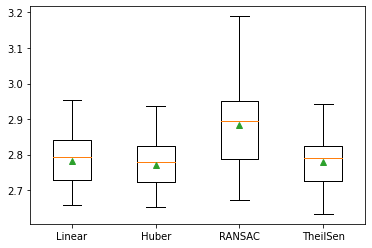

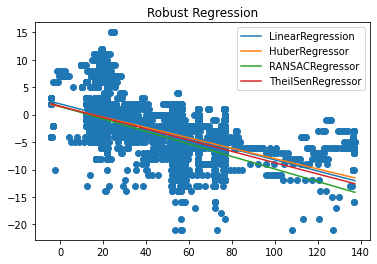

In [12]:
# Load libraries
from matplotlib import pyplot
from sklearn.metrics import mean_squared_error

# Evaluate Logisti Regression Perf
array = LTE_DATA.values
X = array[:,17].reshape(-1, 1)
Y = array[:,6]
#X_train, X_validation, Y_train, Y_validation = train_test_split(X, Y, test_size=0.20, random_state=1)

# linear regression on a dataset with outliers
from random import random
from random import randint
from random import seed
from numpy import arange
from numpy import mean
from numpy import std
from numpy import absolute
from sklearn.datasets import make_regression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import HuberRegressor
from sklearn.linear_model import RANSACRegressor
from sklearn.linear_model import TheilSenRegressor
from sklearn.metrics import mean_squared_error, r2_score
from matplotlib import pyplot
 
# dictionary of model names and model objects
def get_models():
	models = dict()
	models['Linear'] = LinearRegression()
	models['Huber'] = HuberRegressor()
	models['RANSAC'] = RANSACRegressor()
	models['TheilSen'] = TheilSenRegressor()
	return models

# evaluate a model
def evalute_model(X, Y, model, name):
	# define model evaluation method
	cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
	# evaluate model
	scores = cross_val_score(model, X, Y, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1)
	# force scores to be positive
	scores = absolute(scores)
	return scores

# plot the dataset and the model's line of best fit
def plot_best_fit(X, Y, xaxis, model):
	# fit the model on all data
	model.fit(X, Y)
	# calculate outputs for grid across the domain
	yaxis = model.predict(xaxis.reshape((len(xaxis), 1)))
	# plot the line of best fit
	pyplot.plot(xaxis, yaxis, label=type(model).__name__)
 
# get model perf
models = get_models()
results = dict()
for name, model in models.items():
	# evaluate the model
	results[name] = evalute_model(X, Y, model, name)
	# summarize progress
	print('>%s %.3f (%.3f)' % (name, mean(results[name]), std(results[name])))
# plot model performance for comparison
pyplot.boxplot(results.values(), labels=results.keys(), showmeans=True)
pyplot.show()

# define a uniform grid across the input domain
xaxis = arange(X.min(), X.max(), 0.01)
for model in models.items():
	# plot the line of best fit
	plot_best_fit(X, Y, xaxis, model[1])
# plot the dataset
pyplot.scatter(X, Y)
# show the plot
pyplot.title('Robust Regression')
pyplot.legend()
pyplot.show()

In [13]:
LTE_DATA.head()

,interface,timestamp,net_param.net_type,net_param.rsrq,net_param.rsrp,net_param.rssi,net_param.sinr,net_param.band,net_param.pci,uav_param.mode,...,gps_param.altitude,gps_param.groundspeed,gps_param.velocity.vx,gps_param.velocity.vy,gps_param.velocity.vz,gps_param.head,gps_param.hdop,gps_param.vdop,gps_param.satellites,gps_param.fix_type
0,eth1,2021-05-22 13:50:12.752036,LTE,-13.0,-93,-120,2,3,150,POSHOLD,...,16.52,0.114070,-0.08,0.07,0.09,180,71,105,15,4
2,eth1,2021-05-22 13:50:13.786250,LTE,-13.0,-93,-120,2,3,150,POSHOLD,...,16.50,0.099853,-0.06,0.07,0.09,180,71,105,15,4
4,eth1,2021-05-22 13:50:14.846186,LTE,-13.0,-93,-120,2,3,150,POSHOLD,...,16.53,0.091707,-0.04,0.07,0.08,180,71,105,15,4
6,eth1,2021-05-22 13:50:15.794863,LTE,-13.0,-93,-120,2,3,150,POSHOLD,...,16.55,0.078390,-0.01,0.07,0.08,180,71,105,15,4
8,eth1,2021-05-22 13:50:16.856415,LTE,-13.0,-93,-120,2,3,150,POSHOLD,...,16.58,0.082993,-0.02,0.07,0.07,180,71,105,15,4


In [14]:
LTE_RSSI_HM = px.density_mapbox(LTE_DATA, lat='gps_param.latitude', lon='gps_param.longitude', z='net_param.sinr', zoom=12,
                        mapbox_style="open-street-map")

LTE_RSSI_HM.show()


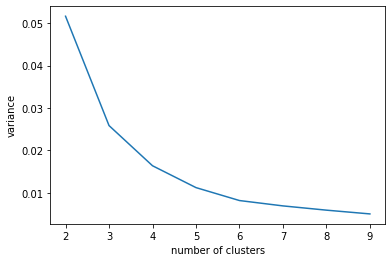

In [15]:
#GEO Clustering attempt
df = DataFrame(LTE_DATA,columns=['gps_param.latitude','gps_param.longitude'])

#Create Elbow plot to find the best number of clusters
nc = []
N = np.arange(2, 10)
for n in N:
    c = KMeans(n_clusters = n).fit(df)
    nc.append(c.inertia_)

plt.plot(N, nc);
plt.xlabel('number of clusters');
plt.ylabel('variance');

[[45.00563432 10.46165463]
 [44.99040582 10.45255975]
 [45.0048522  10.46900559]
 [45.00740329 10.46377573]
 [45.00628912 10.45724244]]


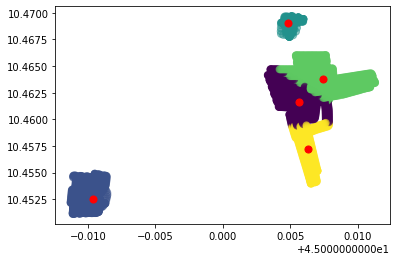

In [16]:
#Set to 5 clusters
kmeans = KMeans(n_clusters=5).fit(df)
centroids = kmeans.cluster_centers_
print(centroids)

plt.scatter(df['gps_param.latitude'], df['gps_param.longitude'], c= kmeans.labels_.astype(float), s=50, alpha=0.5)
plt.scatter(centroids[:, 0], centroids[:, 1], c='red', s=50)
plt.show()

In [17]:
#Lorawan Data Import and Analysis
data = []
with open('LORAWAN.json') as f:
    for line in f:
        data.append(json.loads(line))

LORA_DATA = pd.json_normalize(data)

#Drop duplicate data where rows have same timestamp
LORA_DATA = LORA_DATA.drop_duplicates(subset=['timestamp'])

#Converto DF into float (only numbers)
LORA_DATA = LORA_DATA.apply(pd.to_numeric, errors='ignore')

#Set LORA condition
LORA_Null = LORA_DATA['satellites']>=5
#LORA_net = LORA_DATA['snr'].notna()
#LORA_net = LORA_DATA['gateways'].notna()

#Select only LORA data
LORA_DATA = LORA_DATA[LORA_Null]

#Convert timestamp into datetime
LORA_DATA["timestamp"] = pd.to_datetime(LORA_DATA["timestamp"])

#Sort by time (needed for time clustering)
LORA_DATA = LORA_DATA.sort_values(by="timestamp")

#Print Dtypes for debug
print(LORA_DATA.dtypes)

LORA_DATA.head()

timestamp     datetime64[ns, UTC]
rssi                        int64
snr                       float64
latitude                  float64
longitude                 float64
altitude                  float64
hdop                        int64
satellites                  int64
speed                     float64
head                      float64
gateways                   object
dtype: object


,timestamp,rssi,snr,latitude,longitude,altitude,hdop,satellites,speed,head,gateways
0,2021-05-22 11:51:27.908408+00:00,-107,6.0,44.990883,10.452408,22.890625,66,16,0.106384,176.0,NaN
2,2021-05-22 11:51:35.448530681+00:00,-109,4.0,44.990757,10.452408,24.578125,66,16,3.937500,177.0,NaN
4,2021-05-22 11:51:42.971167228+00:00,-105,7.0,44.990551,10.452424,29.765625,66,16,0.066162,175.0,NaN
6,2021-05-22 11:51:50.512653127+00:00,-101,9.0,44.990551,10.452423,38.250000,66,16,0.137207,176.0,NaN
8,2021-05-22 11:51:58.016596124+00:00,-109,-0.8,44.990528,10.452511,41.625000,66,16,3.958984,105.0,NaN


Found 8 complete flights:
Flight N° 1 has  59  rows of data
Flight N° 2 has  81  rows of data
Flight N° 3 has  184  rows of data
Flight N° 4 has  132  rows of data
Flight N° 5 has  130  rows of data
Flight N° 6 has  135  rows of data
Flight N° 7 has  166  rows of data
Flight N° 8 has  121  rows of data


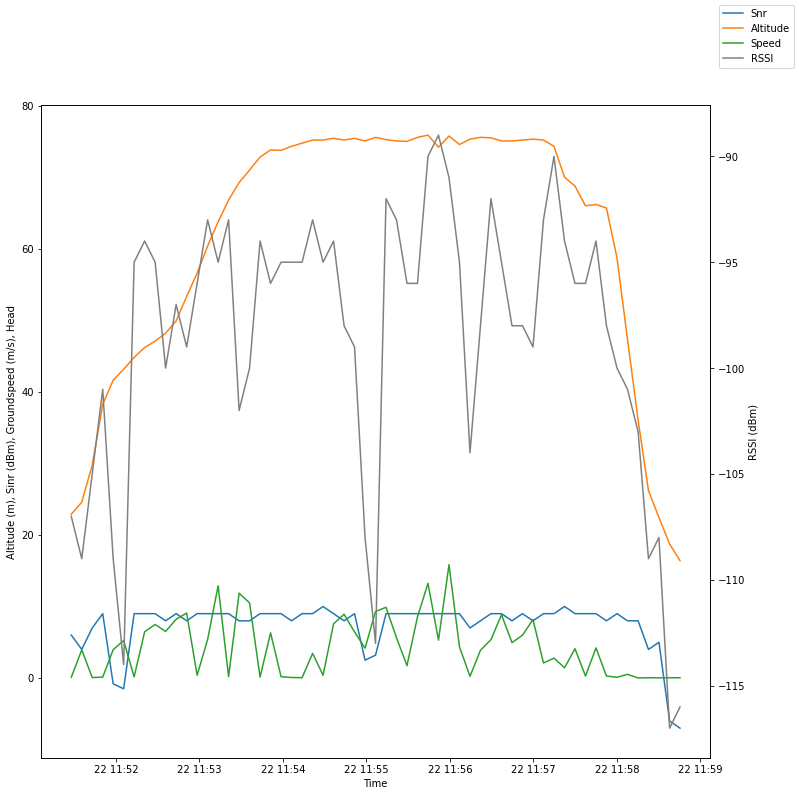

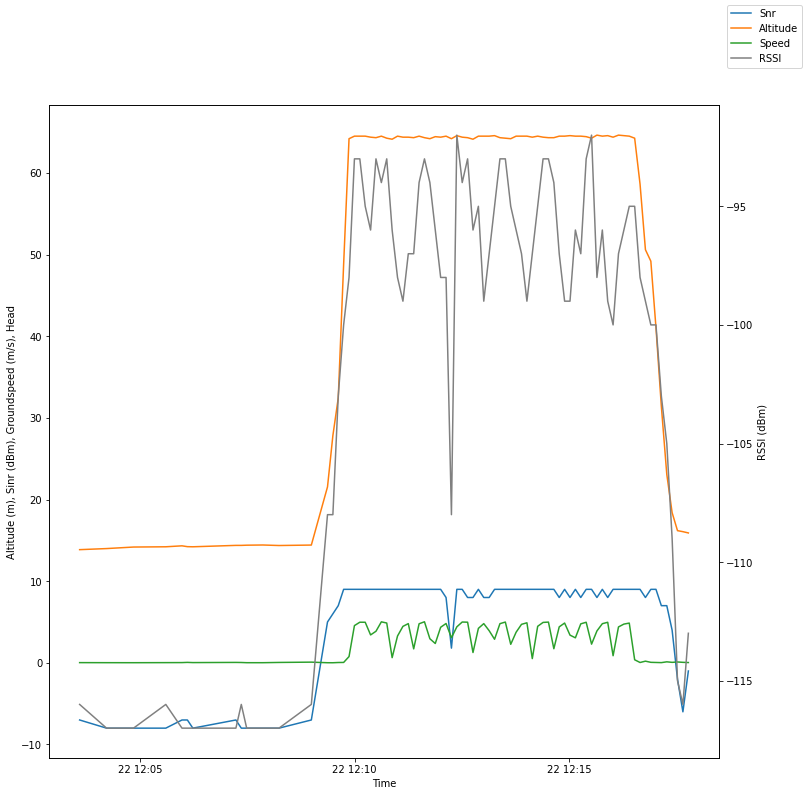

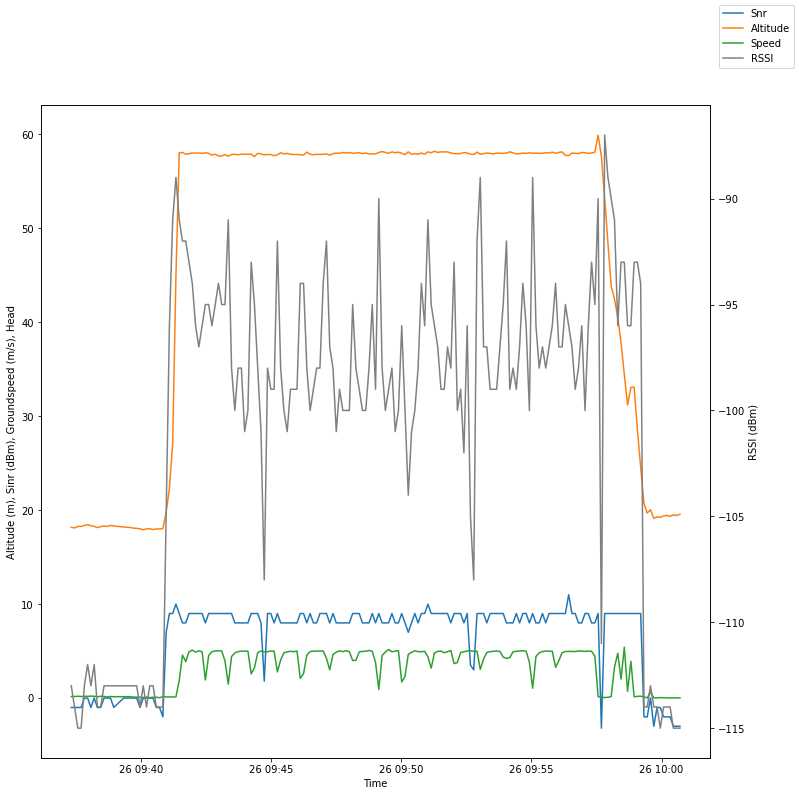

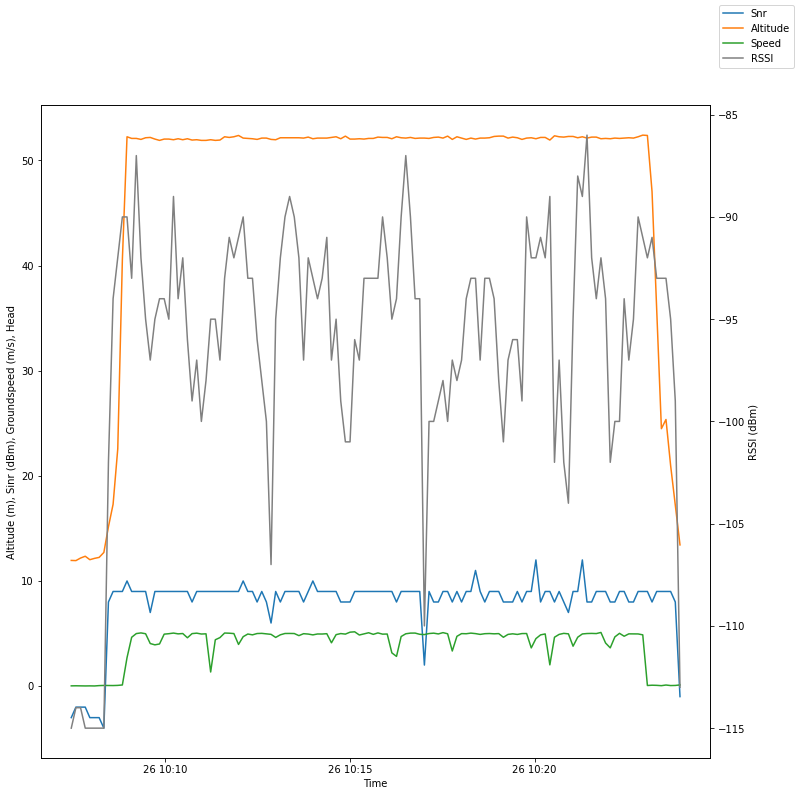

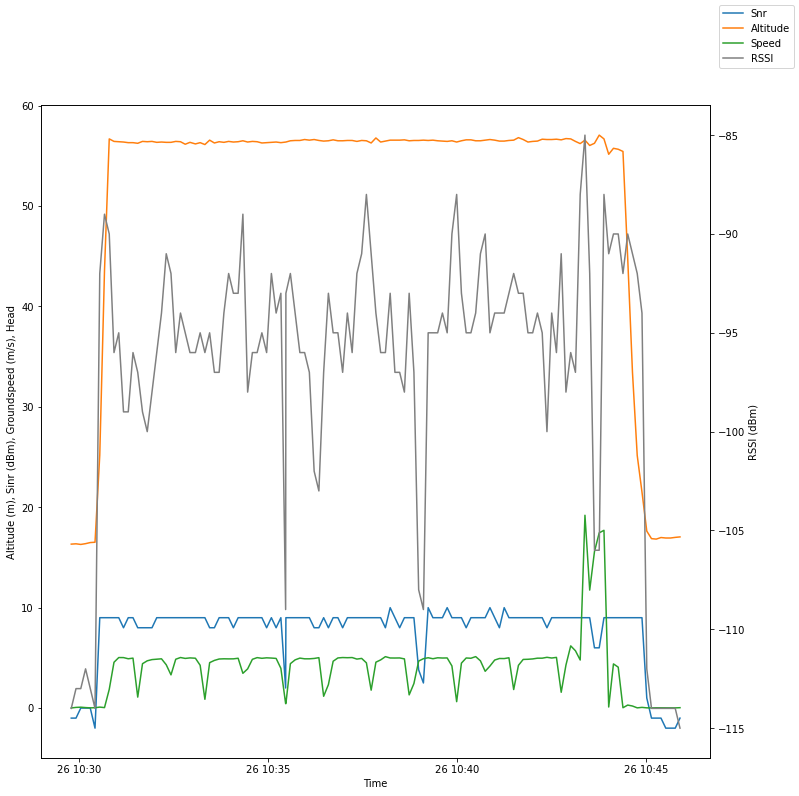

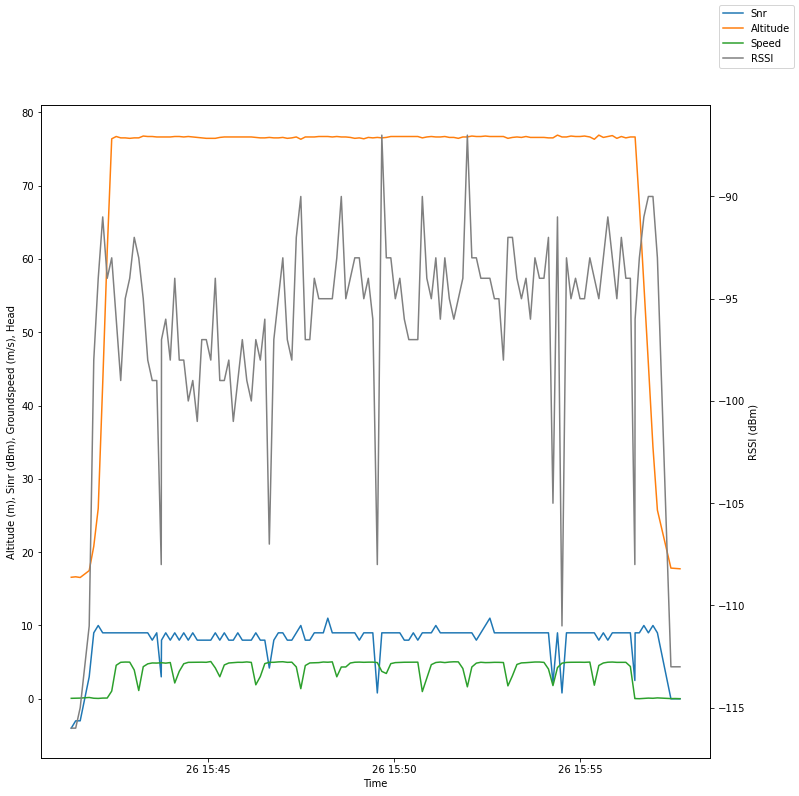

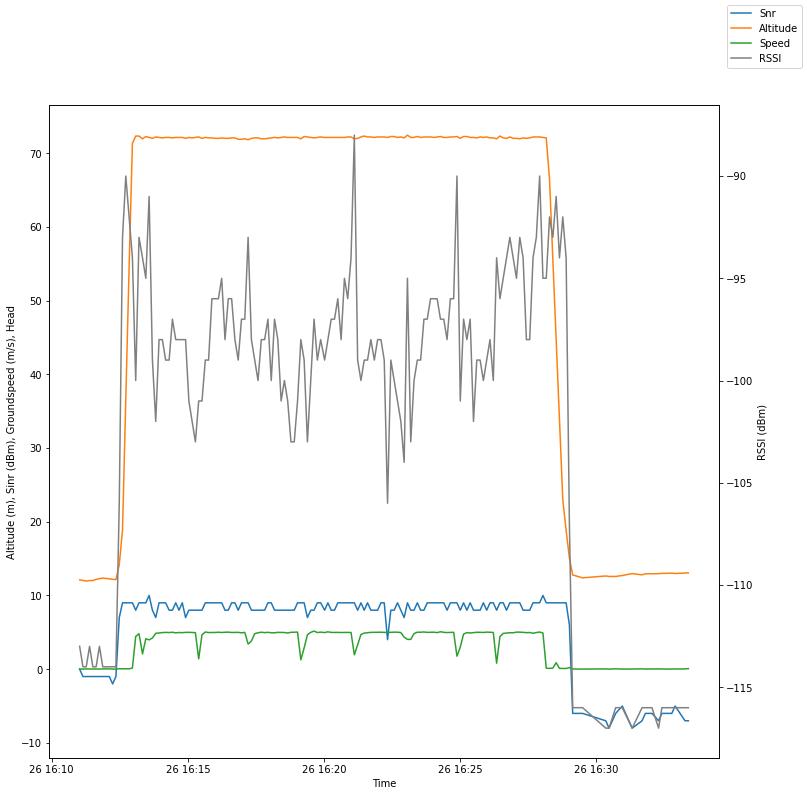

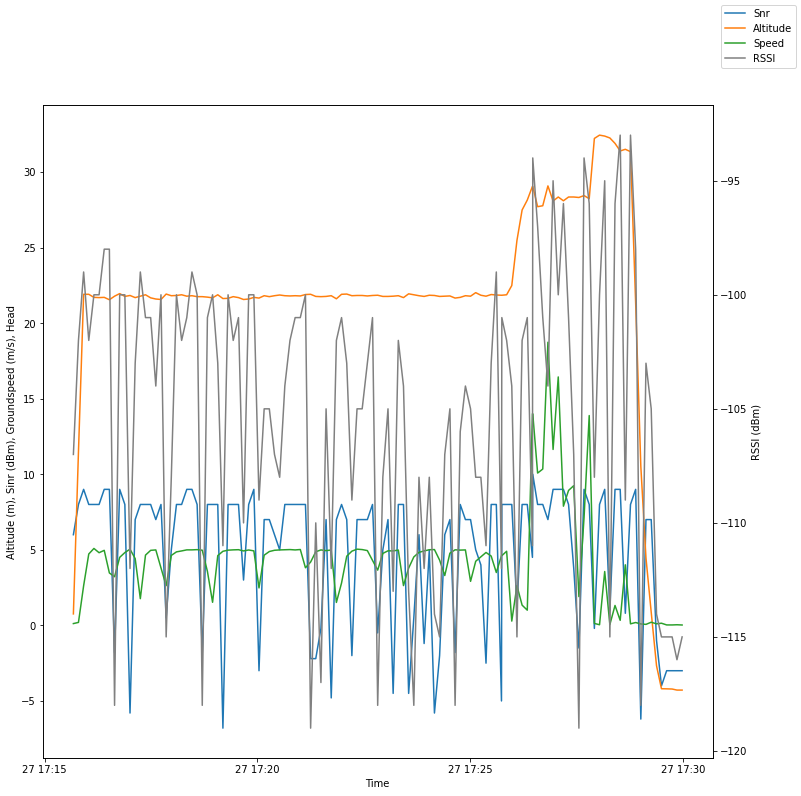

In [18]:
#Convert timestamp of dataframe to python datetime
LORA_DATA.timestamp = LORA_DATA.timestamp.dt.to_pydatetime()

#Define the minimum time difference between flights, in order to identy clusters of data
delta = timedelta(minutes=4)
final = list()
tmp = list()

#First row
tmp.append(LORA_DATA.iloc[0,:])

#First datetime
previous = LORA_DATA.iloc[0,0]

#Scan dataframe looking for clusters and then append them into a list of dataframes
for index, row in islice(LORA_DATA.iterrows(), 1, None):
    dt = row.timestamp
    if dt - previous > delta:
        final.append(tmp)
        tmp = list()
    tmp.append(row)
    previous = dt

#Append last cluster to the list of DF
final.append(tmp)

#Remove flight with less than 50 rows
lora_flights = []
for i in range(len(final)):
    #print(len(final[i]))
    if len(final[i])>50:
        lora_flights.append(final[i])
   
#Remove incomplete flights where there are missing data by check initial and final altitude with a 10 meter error margin due to air pressure change
lora_complete_flights = []
for i in range(len(lora_flights)):
    data = DataFrame (lora_flights[i])
    rth = abs(data.iloc[0,5] - data.iloc[-1,5])
    if rth<10:
        lora_complete_flights.append(data)
    
#Print complete flight
print("Found", len(lora_complete_flights), "complete flights:")
for i in range(len(lora_complete_flights)):
    print("Flight N°", i+1, "has ", len(lora_complete_flights[i]), " rows of data")
    
#Print complete flight data plots
for f in range(len(lora_complete_flights)):
    DF = DataFrame (lora_complete_flights[f])

    #define figures for plots
    fig, ax1 = plt.subplots(figsize = (12, 12))

    #Set first axis data
    ax1.plot(DF['timestamp'], DF['snr'])
    ax1.plot(DF['timestamp'], DF['altitude'])
    ax1.plot(DF['timestamp'], DF['speed'])
    #ax1.plot(DF['timestamp'], DF['head']/10)
    ax1.set_xlabel('Time')
    ax1.set_ylabel('Altitude (m), Sinr (dBm), Groundspeed (m/s), Head')
    #Set second axis data
    ax2 = ax1.twinx()
    ax2.plot(DF['timestamp'], DF['rssi'], color='gray')
    ax2.set_ylabel('RSSI (dBm)')
    #Add legend
    fig.legend(['Snr','Altitude','Speed','RSSI'])
    
    
    plot = px.scatter_mapbox(DF, lat='latitude', lon='longitude', color='snr', size='longitude', zoom=16,
                        mapbox_style="open-street-map")
    plot.show()


In [19]:
from datetime import datetime
from pandas import DataFrame
from pandas import concat
from sklearn.preprocessing import MinMaxScaler
from math import sqrt
from numpy import concatenate
from matplotlib import pyplot
from pandas import concat
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
import keras

# convert series to supervised learning
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
	n_vars = 1 if type(data) is list else data.shape[1]
	df = DataFrame(data)
	cols, names = list(), list()
	# input features (t-n, ... t-1)
	for i in range(n_in, 0, -1):
		cols.append(df.shift(i))
		names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	# forecast outputs (t, t+1, ... t+n)
	for i in range(0, n_out):
		cols.append(df.shift(-i))
		if i == 0:
			names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
		else:
			names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	# put it all together
	agg = concat(cols, axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg

# try to design and fit NN with different LR and neurons
def design_and_fit(train_X, train_Y, test_X, test_Y, neurons, learning_rate):
    # design network
    opt = keras.optimizers.Adam(learning_rate)
    model = Sequential()
    model.add(LSTM(neurons, input_shape=(train_X.shape[1], train_X.shape[2])))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer=opt)
    # fit network
    history = model.fit(train_X, train_Y, epochs=50, batch_size=1, validation_data=(test_X, test_Y), verbose=2, shuffle=False)
    # plot history and. loss
    pyplot.plot(history.history['loss'], label='train')
    pyplot.plot(history.history['val_loss'], label='test')
    pyplot.legend()
    pyplot.show()
    
    return model

# plot the prediction and measurments on the test set
def LSTM_plot(test_X, inv_y, inv_pred_Y):   
    # Create figure
    fig_scat = make_subplots()
    fig_lines = make_subplots()

    #Set first data
    fig_scat.add_trace(go.Scatter(x=test_X[:,1], y=inv_y, mode='markers', name="Measured SNR"))
    fig_scat.add_trace(go.Scatter(x=test_X[:,1], y=inv_pred_Y, mode='markers', name="Predicted SNR"))
    fig_lines.add_trace(go.Scatter(y=inv_y, name="Measured SNR"))
    fig_lines.add_trace(go.Scatter(y=inv_pred_Y, name="Predicted SNR"))
    
    # Set x-axis title
    fig_scat.update_xaxes(title_text="UAV Altitude (m)")
    fig_lines.update_xaxes(title_text="Samples")
    
    # Set y-axes titles
    fig_scat.update_yaxes(title_text="SNR (dBm)")
    fig_lines.update_yaxes(title_text="SNR (dBm)")
    
    # Set title
    fig_scat.update_layout(title_text="SNR Prediction")
    fig_lines.update_layout(title_text="SNR Prediction vs Measured")
    
    # Show
    fig_scat.show()
    fig_lines.show()

DF = LTE_DATA[['net_param.sinr','gps_param.altitude']]
DF = DF.sort_values(by="gps_param.altitude")
data = DF.values

# normalize features
scaler = MinMaxScaler(feature_range=(0, 1))
scaled = scaler.fit_transform(data)
# frame as supervised learning
reframed = series_to_supervised(scaled, 1, 1)
# drop columns we don't want to predict
reframed.drop(reframed.columns[[3]], axis=1, inplace=True)
print(reframed)

#Split into test and train
train, test = train_test_split(reframed.values, test_size=0.30, random_state=18)

#Separate inputs and output
train_X, train_Y = train[:, :-1], train[:, -1] 
test_X, test_Y = test[:, :-1], test[:, -1]

#Reshape input to be 3D [samples, timesteps, features]
train_X = train_X.reshape((train_X.shape[0], 1, train_X.shape[1]))
test_X = test_X.reshape((test_X.shape[0], 1, test_X.shape[1]))
print(train_X.shape, train_Y.shape, test_X.shape, test_Y.shape)

      var1(t-1)  var2(t-1)   var1(t)
1      0.666667   0.000000  0.666667
2      0.666667   0.000000  0.666667
3      0.666667   0.000071  0.666667
4      0.666667   0.000071  0.666667
5      0.666667   0.000141  0.666667
...         ...        ...       ...
6705   0.138889   0.998449  0.444444
6706   0.444444   0.998449  0.416667
6707   0.416667   0.998449  0.388889
6708   0.388889   0.998519  0.444444
6709   0.444444   0.999083  0.444444

[6709 rows x 3 columns]
(4696, 1, 2) (4696,) (2013, 1, 2) (2013,)


Trying to fit NN with 1 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 16s - loss: 0.0423 - val_loss: 0.0228
Epoch 2/5
4696/4696 - 4s - loss: 0.0204 - val_loss: 0.0195
Epoch 3/5
4696/4696 - 4s - loss: 0.0177 - val_loss: 0.0171
Epoch 4/5
4696/4696 - 4s - loss: 0.0155 - val_loss: 0.0153
Epoch 5/5
4696/4696 - 4s - loss: 0.0139 - val_loss: 0.0138


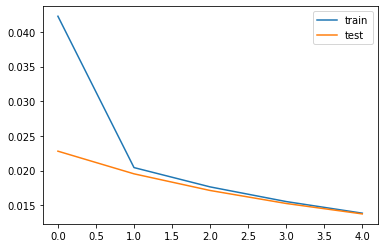

Trying to fit NN with 2 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0616 - val_loss: 0.0157
Epoch 2/5
4696/4696 - 4s - loss: 0.0140 - val_loss: 0.0134
Epoch 3/5
4696/4696 - 4s - loss: 0.0121 - val_loss: 0.0118
Epoch 4/5
4696/4696 - 4s - loss: 0.0108 - val_loss: 0.0107
Epoch 5/5
4696/4696 - 4s - loss: 0.0099 - val_loss: 0.0100


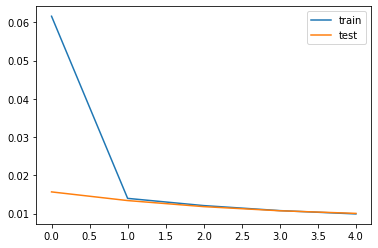

Trying to fit NN with 3 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0482 - val_loss: 0.0181
Epoch 2/5
4696/4696 - 4s - loss: 0.0155 - val_loss: 0.0142
Epoch 3/5
4696/4696 - 4s - loss: 0.0124 - val_loss: 0.0118
Epoch 4/5
4696/4696 - 4s - loss: 0.0105 - val_loss: 0.0104
Epoch 5/5
4696/4696 - 5s - loss: 0.0095 - val_loss: 0.0097


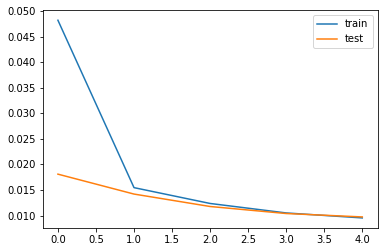

Trying to fit NN with 4 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0566 - val_loss: 0.0131
Epoch 2/5
4696/4696 - 4s - loss: 0.0112 - val_loss: 0.0106
Epoch 3/5
4696/4696 - 4s - loss: 0.0096 - val_loss: 0.0097
Epoch 4/5
4696/4696 - 4s - loss: 0.0091 - val_loss: 0.0095
Epoch 5/5
4696/4696 - 4s - loss: 0.0090 - val_loss: 0.0094


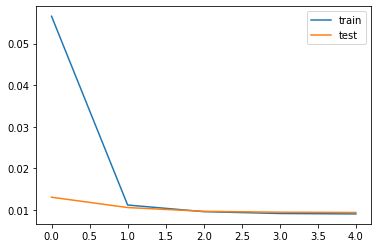

Trying to fit NN with 5 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0757 - val_loss: 0.0149
Epoch 2/5
4696/4696 - 4s - loss: 0.0130 - val_loss: 0.0122
Epoch 3/5
4696/4696 - 4s - loss: 0.0108 - val_loss: 0.0104
Epoch 4/5
4696/4696 - 4s - loss: 0.0096 - val_loss: 0.0096
Epoch 5/5
4696/4696 - 5s - loss: 0.0091 - val_loss: 0.0093


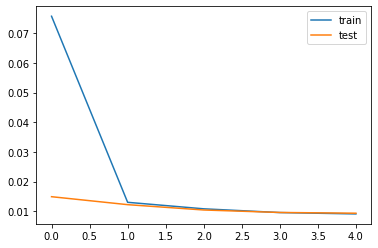

Trying to fit NN with 6 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0583 - val_loss: 0.0137
Epoch 2/5
4696/4696 - 4s - loss: 0.0114 - val_loss: 0.0106
Epoch 3/5
4696/4696 - 4s - loss: 0.0095 - val_loss: 0.0096
Epoch 4/5
4696/4696 - 4s - loss: 0.0090 - val_loss: 0.0094
Epoch 5/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0093


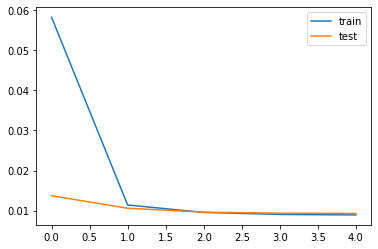

Trying to fit NN with 7 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0328 - val_loss: 0.0113
Epoch 2/5
4696/4696 - 5s - loss: 0.0099 - val_loss: 0.0099
Epoch 3/5
4696/4696 - 5s - loss: 0.0092 - val_loss: 0.0096
Epoch 4/5
4696/4696 - 5s - loss: 0.0090 - val_loss: 0.0095
Epoch 5/5
4696/4696 - 5s - loss: 0.0090 - val_loss: 0.0094


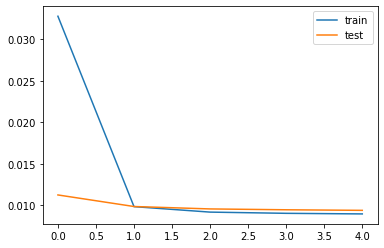

Trying to fit NN with 8 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0654 - val_loss: 0.0169
Epoch 2/5
4696/4696 - 4s - loss: 0.0131 - val_loss: 0.0111
Epoch 3/5
4696/4696 - 4s - loss: 0.0097 - val_loss: 0.0095
Epoch 4/5
4696/4696 - 4s - loss: 0.0090 - val_loss: 0.0092
Epoch 5/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0092


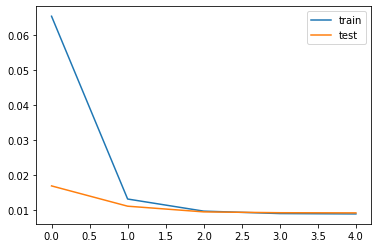

Trying to fit NN with 9 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0442 - val_loss: 0.0120
Epoch 2/5
4696/4696 - 4s - loss: 0.0101 - val_loss: 0.0098
Epoch 3/5
4696/4696 - 5s - loss: 0.0092 - val_loss: 0.0095
Epoch 4/5
4696/4696 - 5s - loss: 0.0090 - val_loss: 0.0094
Epoch 5/5
4696/4696 - 4s - loss: 0.0090 - val_loss: 0.0094


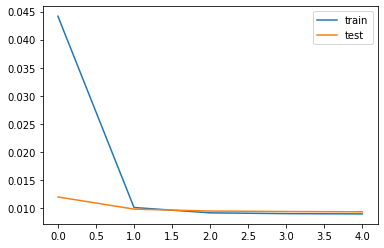

Trying to fit NN with 10 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 5s - loss: 0.0474 - val_loss: 0.0156
Epoch 2/5
4696/4696 - 4s - loss: 0.0122 - val_loss: 0.0107
Epoch 3/5
4696/4696 - 4s - loss: 0.0095 - val_loss: 0.0096
Epoch 4/5
4696/4696 - 4s - loss: 0.0090 - val_loss: 0.0094
Epoch 5/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0093


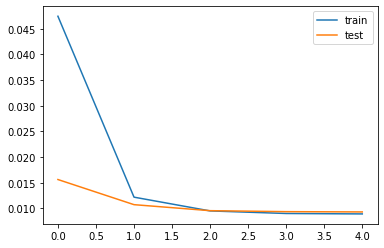

Trying to fit NN with 1 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0360 - val_loss: 0.0161
Epoch 2/5
4696/4696 - 4s - loss: 0.0136 - val_loss: 0.0121
Epoch 3/5
4696/4696 - 4s - loss: 0.0106 - val_loss: 0.0099
Epoch 4/5
4696/4696 - 4s - loss: 0.0092 - val_loss: 0.0092
Epoch 5/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0090


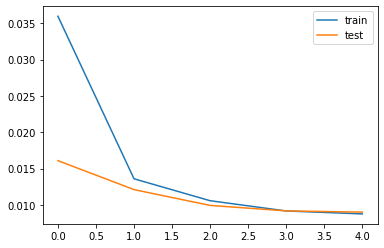

Trying to fit NN with 2 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0255 - val_loss: 0.0092
Epoch 2/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0090
Epoch 3/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0089
Epoch 4/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0089
Epoch 5/5
4696/4696 - 4s - loss: 0.0085 - val_loss: 0.0088


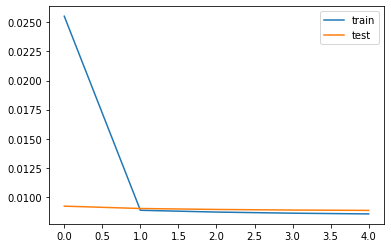

Trying to fit NN with 3 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0252 - val_loss: 0.0097
Epoch 2/5
4696/4696 - 4s - loss: 0.0091 - val_loss: 0.0092
Epoch 3/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0091
Epoch 4/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0091
Epoch 5/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0090


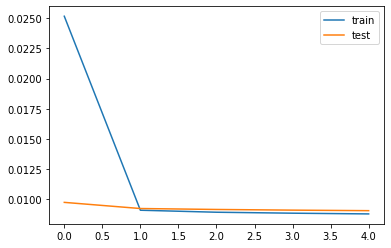

Trying to fit NN with 4 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0146 - val_loss: 0.0095
Epoch 2/5
4696/4696 - 4s - loss: 0.0090 - val_loss: 0.0093
Epoch 3/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0092
Epoch 4/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0091
Epoch 5/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0091


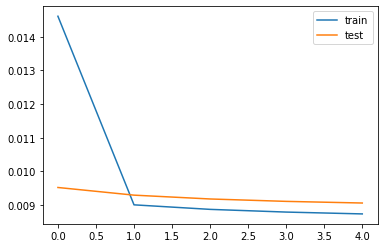

Trying to fit NN with 5 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0219 - val_loss: 0.0093
Epoch 2/5
4696/4696 - 5s - loss: 0.0089 - val_loss: 0.0092
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0091
Epoch 4/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0090
Epoch 5/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0090


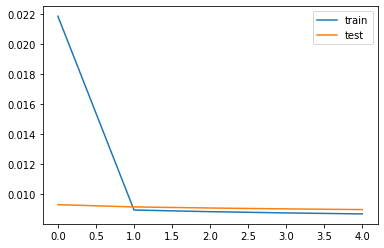

Trying to fit NN with 6 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0198 - val_loss: 0.0095
Epoch 2/5
4696/4696 - 5s - loss: 0.0090 - val_loss: 0.0093
Epoch 3/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0092
Epoch 4/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0091
Epoch 5/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0091


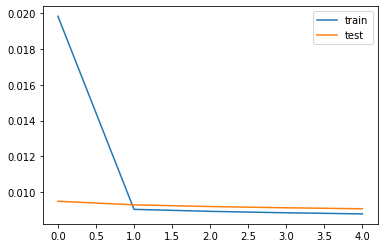

Trying to fit NN with 7 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0202 - val_loss: 0.0092
Epoch 2/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0091
Epoch 3/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0090
Epoch 4/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0090
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0089


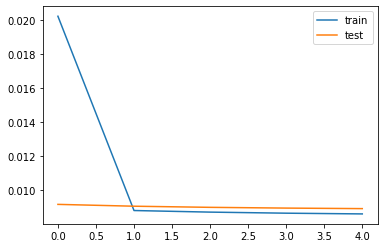

Trying to fit NN with 8 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0206 - val_loss: 0.0093
Epoch 2/5
4696/4696 - 4s - loss: 0.0090 - val_loss: 0.0092
Epoch 3/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0091
Epoch 4/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0090
Epoch 5/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0090


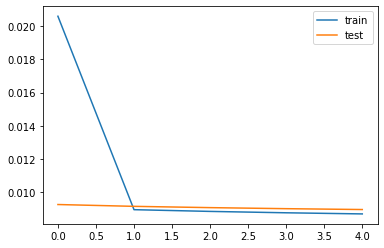

Trying to fit NN with 9 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0170 - val_loss: 0.0093
Epoch 2/5
4696/4696 - 5s - loss: 0.0089 - val_loss: 0.0092
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0091
Epoch 4/5
4696/4696 - 5s - loss: 0.0087 - val_loss: 0.0090
Epoch 5/5
4696/4696 - 5s - loss: 0.0087 - val_loss: 0.0090


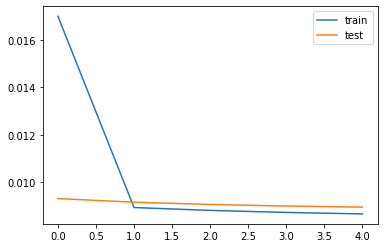

Trying to fit NN with 10 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0169 - val_loss: 0.0093
Epoch 2/5
4696/4696 - 4s - loss: 0.0090 - val_loss: 0.0092
Epoch 3/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0091
Epoch 4/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0091
Epoch 5/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0090


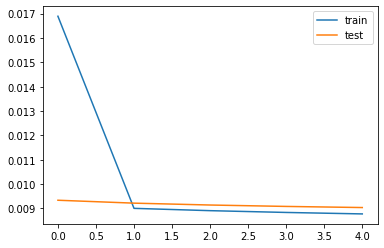

Trying to fit NN with 1 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0161 - val_loss: 0.0094
Epoch 2/5
4696/4696 - 4s - loss: 0.0090 - val_loss: 0.0092
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0091
Epoch 4/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0090
Epoch 5/5
4696/4696 - 5s - loss: 0.0086 - val_loss: 0.0089


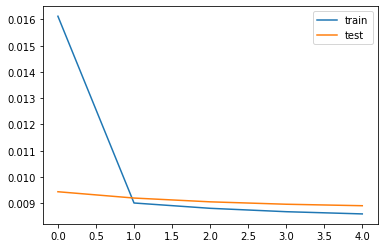

Trying to fit NN with 2 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0170 - val_loss: 0.0092
Epoch 2/5
4696/4696 - 5s - loss: 0.0088 - val_loss: 0.0091
Epoch 3/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0090
Epoch 4/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0089
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0089


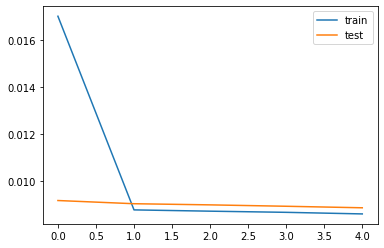

Trying to fit NN with 3 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 7s - loss: 0.0119 - val_loss: 0.0094
Epoch 2/5
4696/4696 - 5s - loss: 0.0089 - val_loss: 0.0091
Epoch 3/5
4696/4696 - 5s - loss: 0.0088 - val_loss: 0.0090
Epoch 4/5
4696/4696 - 5s - loss: 0.0087 - val_loss: 0.0089
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0089


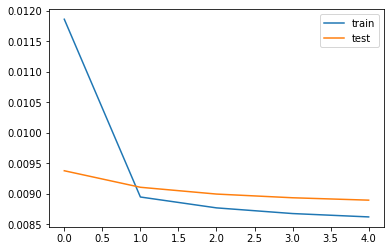

Trying to fit NN with 4 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0164 - val_loss: 0.0093
Epoch 2/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0091
Epoch 3/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0089
Epoch 4/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0089
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0089


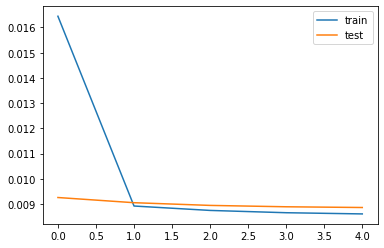

Trying to fit NN with 5 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0188 - val_loss: 0.0091
Epoch 2/5
4696/4696 - 5s - loss: 0.0088 - val_loss: 0.0090
Epoch 3/5
4696/4696 - 5s - loss: 0.0087 - val_loss: 0.0089
Epoch 4/5
4696/4696 - 5s - loss: 0.0086 - val_loss: 0.0089
Epoch 5/5
4696/4696 - 5s - loss: 0.0086 - val_loss: 0.0088


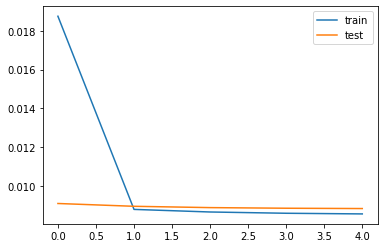

Trying to fit NN with 6 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0145 - val_loss: 0.0092
Epoch 2/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0091
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0090
Epoch 4/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0090
Epoch 5/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0089


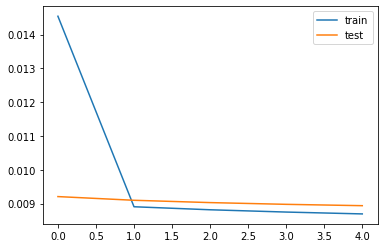

Trying to fit NN with 7 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0132 - val_loss: 0.0092
Epoch 2/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0091
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0090
Epoch 4/5
4696/4696 - 5s - loss: 0.0088 - val_loss: 0.0090
Epoch 5/5
4696/4696 - 5s - loss: 0.0087 - val_loss: 0.0090


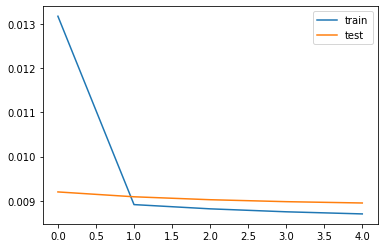

Trying to fit NN with 8 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0130 - val_loss: 0.0091
Epoch 2/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0090
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0089
Epoch 4/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0089
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0088


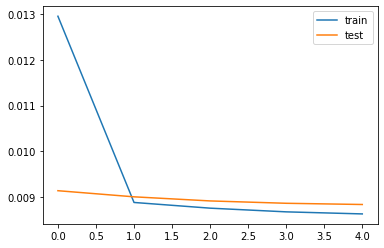

Trying to fit NN with 9 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0129 - val_loss: 0.0092
Epoch 2/5
4696/4696 - 5s - loss: 0.0090 - val_loss: 0.0091
Epoch 3/5
4696/4696 - 5s - loss: 0.0088 - val_loss: 0.0090
Epoch 4/5
4696/4696 - 5s - loss: 0.0087 - val_loss: 0.0089
Epoch 5/5
4696/4696 - 5s - loss: 0.0087 - val_loss: 0.0089


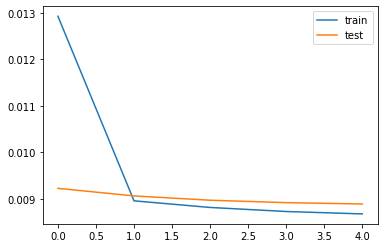

Trying to fit NN with 10 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0128 - val_loss: 0.0092
Epoch 2/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0090
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0090
Epoch 4/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0089
Epoch 5/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0089


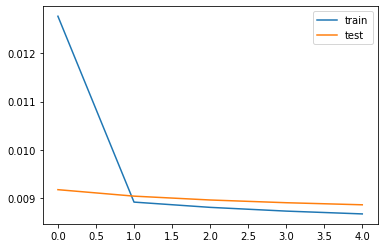

Epoch 1/5
4696/4696 - 6s - loss: 0.0144 - val_loss: 0.0092
Epoch 2/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0090
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0089
Epoch 4/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0089
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0088


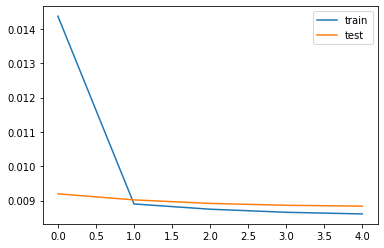

Test RMSE: 3.385


In [20]:
# try to fit for the defined neurons and LR   
neurons = np.arange(1,11,1)
learning_rate = [0.0001,0.001,0.01]

for lr in range(len(learning_rate)):
    for n in range(len(neurons)):
        print("Trying to fit NN with "+str(neurons[n])+" neurons and Learning rate "+str(learning_rate[lr]))
        design_and_fit(train_X, train_Y, test_X, test_Y, neurons[n], learning_rate[lr])
        
#pick the best value and recompute the model for prediction
model = design_and_fit(train_X, train_Y, test_X, test_Y, 8, 0.001)

# make a prediction
pred_Y = model.predict(test_X)
test_X = test_X.reshape((test_X.shape[0], test_X.shape[2]))
test_X = scaler.inverse_transform(test_X)

# invert scaling for forecast
inv_pred_Y = concatenate((pred_Y, test_X[:, 1:]), axis=1)
inv_pred_Y = scaler.inverse_transform(inv_pred_Y)
inv_pred_Y = inv_pred_Y[:,0]

# invert scaling for actual
test_Y = test_Y.reshape((len(test_Y), 1))
inv_y = concatenate((test_Y, test_X[:, 1:]), axis=1)
inv_y = scaler.inverse_transform(inv_y)
inv_y = inv_y[:,0]

# calculate RMSE
rmse = sqrt(mean_squared_error(inv_y, inv_pred_Y))
print('Test RMSE: %.3f' % rmse)

# plot the prediction and measurments on the test set
LSTM_plot(test_X, inv_y, inv_pred_Y)

In [21]:
# make a prediction
X = np.zeros(shape=(141, 2))
X[:,1] = np.arange(0,141,1)
X[:,0] = 0.5

scaled_X = scaler.fit_transform(X)
scaled_X= scaled_X.reshape((scaled_X.shape[0], 1, scaled_X.shape[1]))
Y = model.predict(scaled_X)

inv_pure_Y = concatenate((Y, X[:, 1:]), axis=1)
inv_pure_Y = scaler.inverse_transform(inv_pure_Y)
inv_pure_Y = inv_pure_Y[:,0]


      var1(t-1)  var2(t-1)  var3(t-1)  var4(t-1)  var5(t-1)  var6(t-1)  \
1      0.666667   0.000000   0.733333   0.001852   0.515527   0.805646   
2      0.666667   0.000000   0.733333   0.001130   0.515234   0.803714   
3      0.666667   0.000071   0.733333   0.001166   0.515617   0.805119   
4      0.666667   0.000071   0.733333   0.001770   0.515283   0.804220   
5      0.666667   0.000141   0.733333   0.001106   0.515089   0.803382   
...         ...        ...        ...        ...        ...        ...   
6705   0.138889   0.998449   0.266667   0.260135   0.523965   0.021102   
6706   0.444444   0.998449   0.266667   0.449937   0.382081   0.267064   
6707   0.416667   0.998449   0.066667   0.033075   0.638140   0.630256   
6708   0.388889   0.998519   0.266667   0.019122   0.587853   0.737176   
6709   0.444444   0.999083   0.466667   0.679352   0.268340   0.505986   

      var7(t-1)   var1(t)  
1      0.377908  0.666667  
2      0.377176  0.666667  
3      0.377351  0.666667  

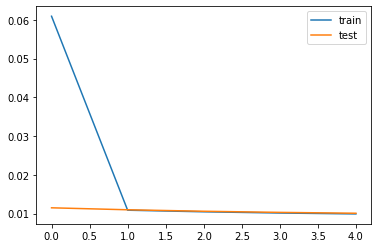

Trying to fit NN with 2 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0187 - val_loss: 0.0143
Epoch 2/5
4696/4696 - 4s - loss: 0.0125 - val_loss: 0.0120
Epoch 3/5
4696/4696 - 4s - loss: 0.0108 - val_loss: 0.0106
Epoch 4/5
4696/4696 - 4s - loss: 0.0099 - val_loss: 0.0099
Epoch 5/5
4696/4696 - 5s - loss: 0.0094 - val_loss: 0.0095


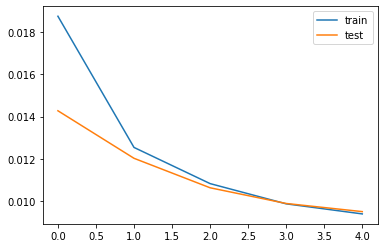

Trying to fit NN with 3 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0317 - val_loss: 0.0141
Epoch 2/5
4696/4696 - 4s - loss: 0.0122 - val_loss: 0.0112
Epoch 3/5
4696/4696 - 4s - loss: 0.0105 - val_loss: 0.0103
Epoch 4/5
4696/4696 - 4s - loss: 0.0099 - val_loss: 0.0099
Epoch 5/5
4696/4696 - 4s - loss: 0.0097 - val_loss: 0.0097


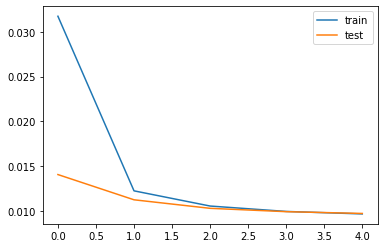

Trying to fit NN with 4 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0447 - val_loss: 0.0112
Epoch 2/5
4696/4696 - 4s - loss: 0.0106 - val_loss: 0.0105
Epoch 3/5
4696/4696 - 4s - loss: 0.0101 - val_loss: 0.0102
Epoch 4/5
4696/4696 - 4s - loss: 0.0099 - val_loss: 0.0100
Epoch 5/5
4696/4696 - 4s - loss: 0.0097 - val_loss: 0.0098


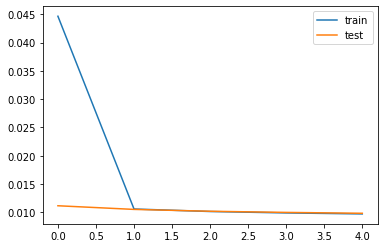

Trying to fit NN with 5 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0398 - val_loss: 0.0157
Epoch 2/5
4696/4696 - 5s - loss: 0.0138 - val_loss: 0.0129
Epoch 3/5
4696/4696 - 5s - loss: 0.0118 - val_loss: 0.0114
Epoch 4/5
4696/4696 - 5s - loss: 0.0107 - val_loss: 0.0105
Epoch 5/5
4696/4696 - 5s - loss: 0.0100 - val_loss: 0.0100


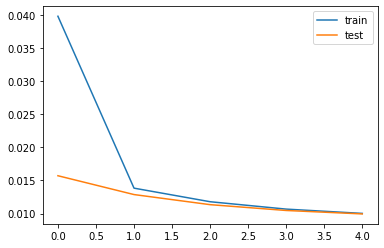

Trying to fit NN with 6 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0708 - val_loss: 0.0158
Epoch 2/5
4696/4696 - 4s - loss: 0.0132 - val_loss: 0.0118
Epoch 3/5
4696/4696 - 4s - loss: 0.0110 - val_loss: 0.0106
Epoch 4/5
4696/4696 - 4s - loss: 0.0103 - val_loss: 0.0101
Epoch 5/5
4696/4696 - 4s - loss: 0.0099 - val_loss: 0.0098


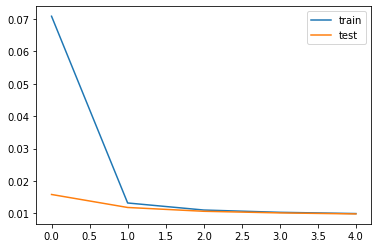

Trying to fit NN with 7 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0229 - val_loss: 0.0114
Epoch 2/5
4696/4696 - 5s - loss: 0.0107 - val_loss: 0.0105
Epoch 3/5
4696/4696 - 5s - loss: 0.0100 - val_loss: 0.0100
Epoch 4/5
4696/4696 - 5s - loss: 0.0097 - val_loss: 0.0097
Epoch 5/5
4696/4696 - 5s - loss: 0.0095 - val_loss: 0.0095


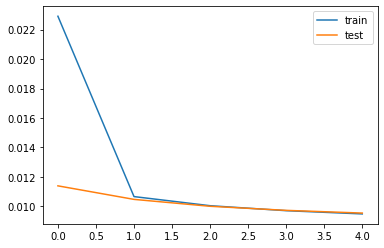

Trying to fit NN with 8 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0339 - val_loss: 0.0164
Epoch 2/5
4696/4696 - 4s - loss: 0.0123 - val_loss: 0.0107
Epoch 3/5
4696/4696 - 4s - loss: 0.0098 - val_loss: 0.0097
Epoch 4/5
4696/4696 - 4s - loss: 0.0093 - val_loss: 0.0094
Epoch 5/5
4696/4696 - 4s - loss: 0.0091 - val_loss: 0.0092


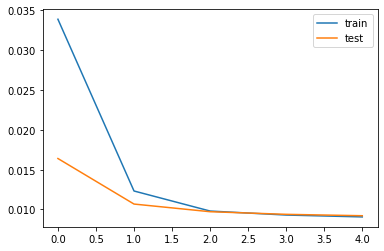

Trying to fit NN with 9 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0279 - val_loss: 0.0122
Epoch 2/5
4696/4696 - 5s - loss: 0.0106 - val_loss: 0.0099
Epoch 3/5
4696/4696 - 5s - loss: 0.0096 - val_loss: 0.0095
Epoch 4/5
4696/4696 - 5s - loss: 0.0093 - val_loss: 0.0093
Epoch 5/5
4696/4696 - 5s - loss: 0.0092 - val_loss: 0.0092


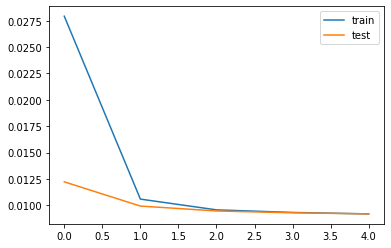

Trying to fit NN with 10 neurons and Learning rate 0.0001
Epoch 1/5
4696/4696 - 6s - loss: 0.0508 - val_loss: 0.0153
Epoch 2/5
4696/4696 - 4s - loss: 0.0125 - val_loss: 0.0112
Epoch 3/5
4696/4696 - 4s - loss: 0.0100 - val_loss: 0.0097
Epoch 4/5
4696/4696 - 4s - loss: 0.0093 - val_loss: 0.0093
Epoch 5/5
4696/4696 - 4s - loss: 0.0091 - val_loss: 0.0092


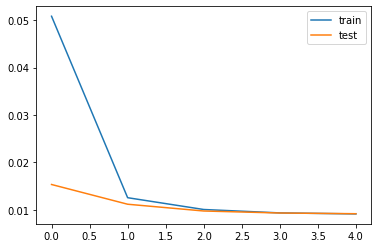

Trying to fit NN with 1 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0261 - val_loss: 0.0112
Epoch 2/5
4696/4696 - 4s - loss: 0.0101 - val_loss: 0.0097
Epoch 3/5
4696/4696 - 4s - loss: 0.0093 - val_loss: 0.0093
Epoch 4/5
4696/4696 - 4s - loss: 0.0091 - val_loss: 0.0091
Epoch 5/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0090


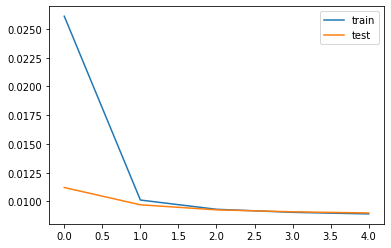

Trying to fit NN with 2 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0241 - val_loss: 0.0099
Epoch 2/5
4696/4696 - 4s - loss: 0.0091 - val_loss: 0.0090
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0089
Epoch 4/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0088
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0088


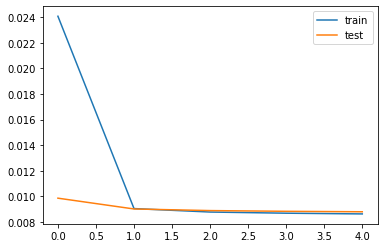

Trying to fit NN with 3 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0194 - val_loss: 0.0106
Epoch 2/5
4696/4696 - 4s - loss: 0.0094 - val_loss: 0.0092
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0089
Epoch 4/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0088
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0088


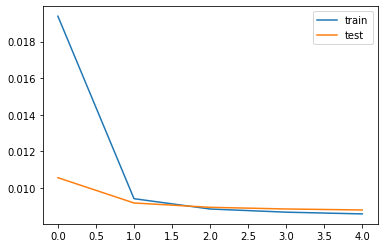

Trying to fit NN with 4 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0210 - val_loss: 0.0098
Epoch 2/5
4696/4696 - 4s - loss: 0.0091 - val_loss: 0.0090
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0089
Epoch 4/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0088
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0088


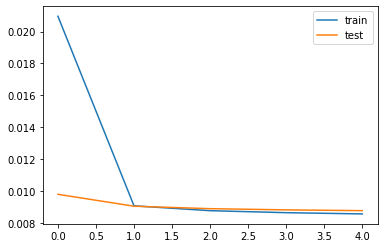

Trying to fit NN with 5 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0192 - val_loss: 0.0101
Epoch 2/5
4696/4696 - 5s - loss: 0.0096 - val_loss: 0.0093
Epoch 3/5
4696/4696 - 5s - loss: 0.0091 - val_loss: 0.0091
Epoch 4/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0089
Epoch 5/5
4696/4696 - 5s - loss: 0.0088 - val_loss: 0.0089


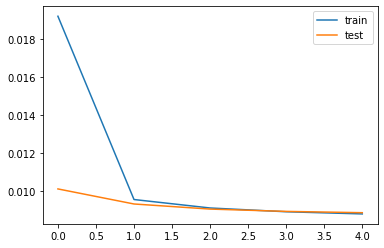

Trying to fit NN with 6 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0191 - val_loss: 0.0094
Epoch 2/5
4696/4696 - 5s - loss: 0.0091 - val_loss: 0.0090
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0088
Epoch 4/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0087
Epoch 5/5
4696/4696 - 4s - loss: 0.0085 - val_loss: 0.0087


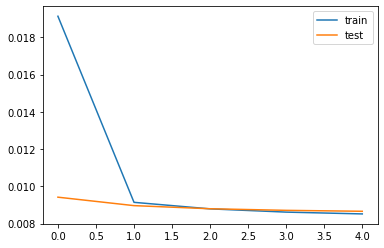

Trying to fit NN with 7 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0170 - val_loss: 0.0093
Epoch 2/5
4696/4696 - 5s - loss: 0.0090 - val_loss: 0.0091
Epoch 3/5
4696/4696 - 5s - loss: 0.0088 - val_loss: 0.0089
Epoch 4/5
4696/4696 - 5s - loss: 0.0087 - val_loss: 0.0089
Epoch 5/5
4696/4696 - 5s - loss: 0.0086 - val_loss: 0.0088


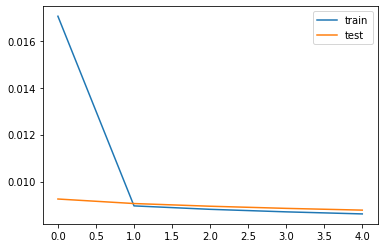

Trying to fit NN with 8 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0135 - val_loss: 0.0097
Epoch 2/5
4696/4696 - 4s - loss: 0.0093 - val_loss: 0.0091
Epoch 3/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0089
Epoch 4/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0088
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0087


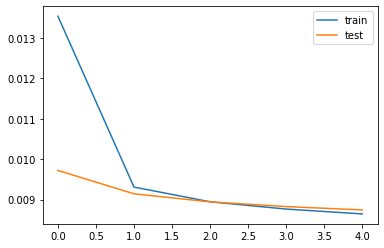

Trying to fit NN with 9 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0154 - val_loss: 0.0094
Epoch 2/5
4696/4696 - 5s - loss: 0.0090 - val_loss: 0.0090
Epoch 3/5
4696/4696 - 5s - loss: 0.0088 - val_loss: 0.0088
Epoch 4/5
4696/4696 - 5s - loss: 0.0086 - val_loss: 0.0087
Epoch 5/5
4696/4696 - 5s - loss: 0.0085 - val_loss: 0.0087


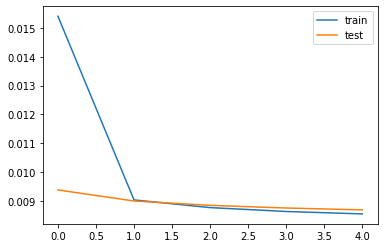

Trying to fit NN with 10 neurons and Learning rate 0.0005
Epoch 1/5
4696/4696 - 6s - loss: 0.0131 - val_loss: 0.0092
Epoch 2/5
4696/4696 - 4s - loss: 0.0090 - val_loss: 0.0090
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0088
Epoch 4/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0087
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0087


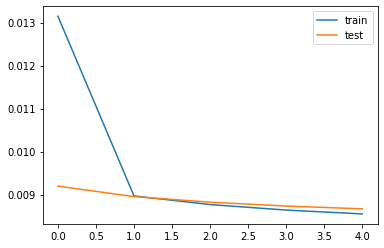

Trying to fit NN with 1 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0245 - val_loss: 0.0095
Epoch 2/5
4696/4696 - 4s - loss: 0.0090 - val_loss: 0.0088
Epoch 3/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0087
Epoch 4/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0087
Epoch 5/5
4696/4696 - 4s - loss: 0.0085 - val_loss: 0.0087


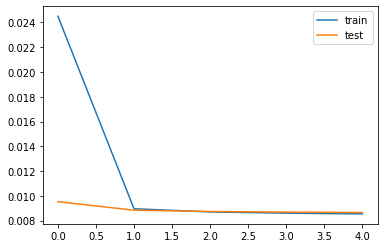

Trying to fit NN with 2 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0135 - val_loss: 0.0094
Epoch 2/5
4696/4696 - 4s - loss: 0.0092 - val_loss: 0.0090
Epoch 3/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0089
Epoch 4/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0088
Epoch 5/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0088


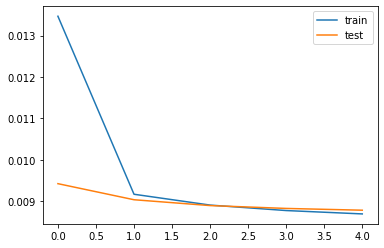

Trying to fit NN with 3 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0139 - val_loss: 0.0092
Epoch 2/5
4696/4696 - 4s - loss: 0.0090 - val_loss: 0.0088
Epoch 3/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0087
Epoch 4/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0086
Epoch 5/5
4696/4696 - 4s - loss: 0.0085 - val_loss: 0.0086


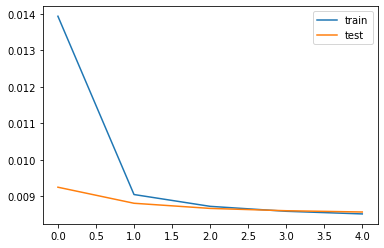

Trying to fit NN with 4 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0227 - val_loss: 0.0092
Epoch 2/5
4696/4696 - 4s - loss: 0.0091 - val_loss: 0.0089
Epoch 3/5
4696/4696 - 4s - loss: 0.0088 - val_loss: 0.0088
Epoch 4/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0087
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0086


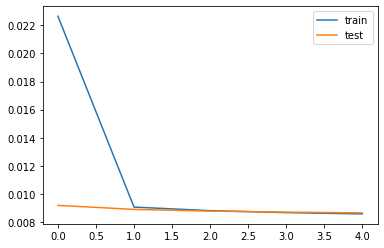

Trying to fit NN with 5 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0132 - val_loss: 0.0092
Epoch 2/5
4696/4696 - 5s - loss: 0.0089 - val_loss: 0.0087
Epoch 3/5
4696/4696 - 5s - loss: 0.0086 - val_loss: 0.0086
Epoch 4/5
4696/4696 - 5s - loss: 0.0085 - val_loss: 0.0085
Epoch 5/5
4696/4696 - 5s - loss: 0.0084 - val_loss: 0.0085


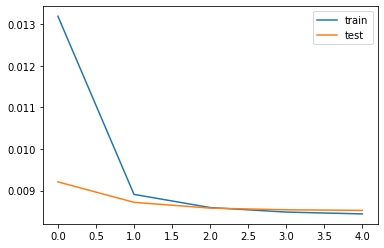

Trying to fit NN with 6 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0121 - val_loss: 0.0089
Epoch 2/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0087
Epoch 3/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0086
Epoch 4/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0086
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0086


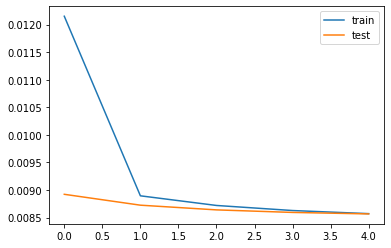

Trying to fit NN with 7 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0155 - val_loss: 0.0089
Epoch 2/5
4696/4696 - 5s - loss: 0.0088 - val_loss: 0.0087
Epoch 3/5
4696/4696 - 5s - loss: 0.0087 - val_loss: 0.0086
Epoch 4/5
4696/4696 - 5s - loss: 0.0086 - val_loss: 0.0086
Epoch 5/5
4696/4696 - 5s - loss: 0.0086 - val_loss: 0.0086


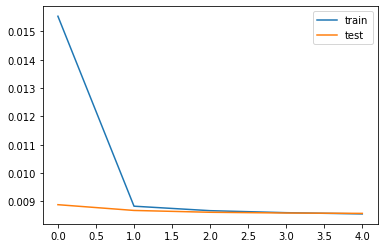

Trying to fit NN with 8 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0132 - val_loss: 0.0090
Epoch 2/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0087
Epoch 3/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0086
Epoch 4/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0086
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0085


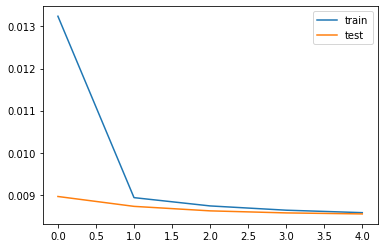

Trying to fit NN with 9 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0118 - val_loss: 0.0089
Epoch 2/5
4696/4696 - 5s - loss: 0.0088 - val_loss: 0.0087
Epoch 3/5
4696/4696 - 5s - loss: 0.0087 - val_loss: 0.0086
Epoch 4/5
4696/4696 - 5s - loss: 0.0086 - val_loss: 0.0086
Epoch 5/5
4696/4696 - 5s - loss: 0.0085 - val_loss: 0.0086


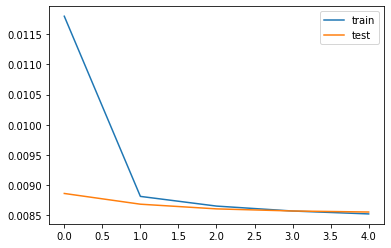

Trying to fit NN with 10 neurons and Learning rate 0.001
Epoch 1/5
4696/4696 - 6s - loss: 0.0123 - val_loss: 0.0089
Epoch 2/5
4696/4696 - 4s - loss: 0.0089 - val_loss: 0.0087
Epoch 3/5
4696/4696 - 4s - loss: 0.0087 - val_loss: 0.0086
Epoch 4/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0086
Epoch 5/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0086


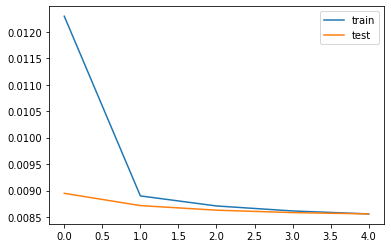

In [22]:
# Another NN for LSTM but with all UAV flight parameters as features (7 inputs)
DF = LTE_DATA[['net_param.sinr','gps_param.altitude','net_param.rsrq','gps_param.groundspeed','uav_param.attitude.pitch','uav_param.attitude.yaw','uav_param.attitude.roll']]
DF = DF.sort_values(by="gps_param.altitude")
data = DF.values

# normalize features
scaler = MinMaxScaler(feature_range=(0, 1))
scaled = scaler.fit_transform(data)
# frame as supervised learning
reframed = series_to_supervised(scaled, 1, 1)
# drop columns we don't want to predict
reframed.drop(reframed.columns[[8,9,10,11,12,13]], axis=1, inplace=True)
print(reframed)

#Split into test and train
train, test = train_test_split(reframed.values, test_size=0.30, random_state=18)

#Separate inputs and output
train_X, train_Y = train[:, :-1], train[:, -1] 
test_X, test_Y = test[:, :-1], test[:, -1]

#Reshape input to be 3D [samples, timesteps, features]
train_X = train_X.reshape((train_X.shape[0], 1, train_X.shape[1]))
test_X = test_X.reshape((test_X.shape[0], 1, test_X.shape[1]))
print(train_X.shape, train_Y.shape, test_X.shape, test_Y.shape)

# try to fit for the defined number of neurons and LR
neurons = np.arange(1,11,1)
learning_rate = [0.0001,0.001,0.01]

for lr in range(len(learning_rate)):
    for n in range(len(neurons)):
        print("Trying to fit NN with "+str(neurons[n])+" neurons and Learning rate "+str(learning_rate[lr]))
        design_and_fit(train_X, train_Y, test_X, test_Y, neurons[n], learning_rate[lr])

Epoch 1/5
4696/4696 - 6s - loss: 0.0128 - val_loss: 0.0092
Epoch 2/5
4696/4696 - 4s - loss: 0.0090 - val_loss: 0.0088
Epoch 3/5
4696/4696 - 5s - loss: 0.0087 - val_loss: 0.0087
Epoch 4/5
4696/4696 - 4s - loss: 0.0086 - val_loss: 0.0086
Epoch 5/5
4696/4696 - 4s - loss: 0.0085 - val_loss: 0.0086


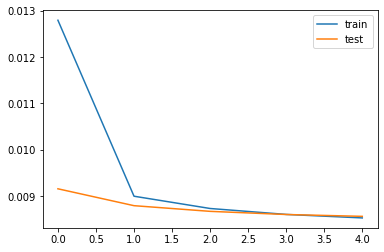

Test RMSE: 3.332


In [23]:
#pick the best value and recompute the model for prediction
model = design_and_fit(train_X, train_Y, test_X, test_Y, 7, 0.001)

# make a prediction on the best model
pred_Y = model.predict(test_X)
test_X = test_X.reshape((test_X.shape[0], test_X.shape[2]))
test_X = scaler.inverse_transform(test_X)

# invert scaling for forecast
inv_pred_Y = concatenate((pred_Y, test_X[:, 1:]), axis=1)
inv_pred_Y = scaler.inverse_transform(inv_pred_Y)
inv_pred_Y = inv_pred_Y[:,0]

# invert scaling for actual
test_Y = test_Y.reshape((len(test_Y), 1))
inv_y = concatenate((test_Y, test_X[:, 1:]), axis=1)
inv_y = scaler.inverse_transform(inv_y)
inv_y = inv_y[:,0]

# calculate RMSE
rmse = sqrt(mean_squared_error(inv_y, inv_pred_Y))
print('Test RMSE: %.3f' % rmse)

# plot the prediction and measurments on the test set
LSTM_plot(test_X, inv_y, inv_pred_Y)

In [ ]:
# trying to play with Convolutional Neural Network


In [24]:
#Since there was some missing fields (RSSI and SNR) in the lastest measurment, which where included into gateways, I extracted these value from that field and I rewrite the file with the missing values of RSSI and SNR
for rows in data:
    if 'gateways' in rows:
        #print(rows['gateways'])
        #print(type(rows['gateways']))
        RSSI = []
        SNR = []
        for value in range(len(rows["gateways"])):
            RSSI.append(rows["gateways"][value]["rssi"])
            SNR.append(rows["gateways"][value]["snr"])
        output = {"timestamp":rows["timestamp"],"rssi":max(RSSI), "snr":max(SNR), "latitude":rows['latitude'],"longitude":rows['longitude'],"altitude":rows['altitude'],"hdop":rows['hdop'],"satellites":rows['satellites'],"speed":rows['speed'],"head":rows['head'],"gateways":rows["gateways"]}
        print(output)
    else:
        output = rows
        
    #with open('LORAWAN_CLEAN.json', 'a') as outfile:
        #json.dump(output, outfile, ensure_ascii=False)
        #outfile.write('\n')
        

<ipython-input-24-e35380d58334>:3: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison

